<img src="https://s3.amazonaws.com/weclouddata/images/logos/wcd_logo_new_2.png" width="10%">
<h1><center>Computer Vision Project Template (Object Detection)</center></h1>

---

For this notebook, we will be using the Project Template.

The goal of the template is to make the Capstone Project implementation easy for the user.

# ML Project

There are 5 core components of a ML Project:
- Problem Statement
- Dataset
- DL Model
- Model Training
- Model Evaluation

The Template provides wrappers (Data and Model classes) and an API (ModelEngine) that works hand-in-hand with a Configuration. Together, they form a complete Training API.


Download and install the template

In [1]:
# !git clone https://github.com/jjaskirat/wcd_project_template.git
# %cd wcd_project_template
# ! python setup.py install
# %cd ..

In [2]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

imports

In [3]:
import time
import os
import copy
from typing import Optional, Callable, Tuple

import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2
import random
import segmentation_models_pytorch as smp
from sklearn.model_selection import train_test_split
import timm
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import pandas as pd
import torchvision
from torchvision import models, transforms
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt

/opt/conda/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Problem Statement

---

Automatic Target Recognition (ATR), which is the task of automatically
detecting targets in images, has an history of more than 35 years of research
and development in the computer vision community. The basic aim of such
ATR systems is to assist or remove the role of man from the process of de-
tecting and recognizing targets and hence to implement efficient and reliable
systems of high performance. One typical application is surveillance and
reconnaissance, two tasks which need to be more and more automatic, as
recent high resolution surveillance sensors produce imagery with high data
bandwidth. As explained by Wong [1], a surveillance mission over a 200 mile
square area with a one foot resolution (an appropriate size for recognizing
many targets), will generate approximately 1.5 × 1012 pixels of data. If the
area is split in 10 million pixels images, photo interpreters would have to
examine over 100,000 images, which is an impractical workload and results
in a delayed or incomplete analysis. In addition, the delay would allow mov-
able targets to relocate so that they cannot be found in subsequent missions.
Vehicle detection is hence of crucial matter in defense applications.

## Dataset

---

**Content**

VEDAI is a dataset for Vehicle Detection in Aerial Imagery, provided as a tool to benchmark automatic target recognition algorithms in unconstrained environments. The vehicles contained in the database, in addition of being small, exhibit different variabilities such as multiple orientations, lighting/shadowing changes, specularities or occlusions. Furthermore, each image is available in several spectral bands and resolutions. A precise experimental protocol is also given, ensuring that the experimental results obtained by different people can be properly reproduced and compared. We also give the performance of some baseline algorithms on this dataset, for different settings of these algorithms, to illustrate the difficulties of the task and provide baseline comparisons.

**Acknowledgements**

Data source: https://downloads.greyc.fr/vedai/

Kindly contact (frederic.jurie@unicaen.fr) for questions, comments etc. about the database.

Vehicle Detection in Aerial Imagery: A small target detection benchmark., Sébastien Razakarivony and Frédéric Jurie, Journal of Visual Communication and Image Representation, 2015

In [4]:
# Download the data from the provided link and place it in the ROOT_DIR

ROOT_DIR = '/data/we_cloud_data/vedai/'

In [5]:
os.listdir(ROOT_DIR)

['Annotations512',
 'Annotations512.tar',
 'DevKit.tar',
 'Vehicules512.tar.002',
 'Vehicules512.tar',
 'Vehicules512',
 'Vehicules512.tar.001',
 'DevKit']

Merge all parts files into one

In [6]:
# --------------Do not run again --------------
# Please note /data/we_cloud_data/vedai is ROOT_DIR

# !cat /data/we_cloud_data/vedai/Vehicules512.tar.00* >/data/we_cloud_data/vedai/Vehicules512.tar

Extract all files

In [7]:
# --------------Do not run again --------------

# import tarfile

# tar = tarfile.open(f'{ROOT_DIR}/Annotations512.tar', "r:")
# tar.extractall(ROOT_DIR)
# tar.close()

# tar = tarfile.open(f'{ROOT_DIR}/Vehicules512.tar', "r:")
# tar.extractall(ROOT_DIR)
# tar.close()

# tar = tarfile.open(f'{ROOT_DIR}/DevKit.tar', "r:")
# tar.extractall(ROOT_DIR)
# tar.close()

Creation of DataFrame for dataset

The DataFrame will contain relative paths of the images and the labels of the dataset

In [8]:
def create_df():
    image_files = []
    label_files = []

    # Loop through all the images
    for image_path in os.listdir(f'{ROOT_DIR}/Vehicules512'):
        # 00001_co.png or 00001_ir.png
        # 00001_co or 00001_ir
        image_id_with_type = image_path.split('.')[0]
        # 00001
        image_id = image_id_with_type.split('_')[0]
        # 'co' or 'ir'
        image_type = image_id_with_type.split('_')[1]
        # Filter out the coloured images (denoted by 'co')
        if image_type == 'co':
            # If coloured image, add image and label to dataset
            image_files.append(f'Vehicules512/{image_path}')
            label_files.append(f'Annotations512/{image_id}.txt')

    df = pd.DataFrame({
        'image': image_files,
        'label': label_files
    })
    return df

df = create_df()
print('Total Images: ', len(df))

Total Images:  1246


In [9]:
df

,image,label
0,Vehicules512/00001112_co.png,Annotations512/00001112.txt
1,Vehicules512/00001212_co.png,Annotations512/00001212.txt
2,Vehicules512/00000224_co.png,Annotations512/00000224.txt
3,Vehicules512/00000015_co.png,Annotations512/00000015.txt
4,Vehicules512/00000079_co.png,Annotations512/00000079.txt
...,...,...
1241,Vehicules512/00001146_co.png,Annotations512/00001146.txt
1242,Vehicules512/00000660_co.png,Annotations512/00000660.txt
1243,Vehicules512/00000388_co.png,Annotations512/00000388.txt
1244,Vehicules512/00000769_co.png,Annotations512/00000769.txt


## Data Exploration and Viusualization

In [10]:
label_dict = {
    1: 'car',
    2:'trucks',
    4: 'tractors',
    5: 'camping cars',
    7: 'motorcycles',
    8:'buses',
    9: 'vans',
    10: 'others',
    3: 'pickup',
    6: 'boats',
    11: 'Small Land Vehicles',
    12: 'Large land Vehicles',
}

Helper Functions to load data

In [11]:
from torchvision import tv_tensors

def preprocess_label(label_path: os.PathLike[str], img_size=512) -> pd.core.frame.DataFrame:
    """Converts the given format into the XYXY (pascal) format

    Args:
        label_path (os.PathLike[str]): path of the label file
        img_size (int, optional): size of image. Defaults to 512.

    Returns:
        pd.core.frame.DataFrame: df of the XYXY format where each row is one box
    """
    with open(label_path, 'r') as file:
        # Data file cleaning
        # Replace the tabs by space
        data = file.read()
        text = '\n'.join(' '.join(line.split()) for line in data.split('\n'))
        text.replace('\t', ' ')

        # Read the label file as a csv
        # In the given format, the bounding box is rotated by an angle.
        # The rotation information is in the orientation column
        data = pd.read_csv(
            label_path,
            sep=' ',
            index_col=None,
            header=None,
            names=[
                'x_center',
                'y_center',
                'orientation',
                'class',
                'is_contained',
                'is_occluded',
                'corner1_x',
                'corner2_x',
                'corner3_x',
                'corner4_x',
                'corner1_y',
                'corner2_y',
                'corner3_y',
                'corner4_y'
            ]
        )
        
        # Some columns in the file contain invalid information.
        # That the edge of the label > size of the image
        # To convert them to a valid bounding box,
        # Clip all the edges to the size of the image
        clip_cols = [
            'corner1_x',
            'corner2_x',
            'corner3_x',
            'corner4_x',
            'corner1_y',
            'corner2_y',
            'corner3_y',
            'corner4_y'
        ]
        
        data[clip_cols] = data[clip_cols].clip(upper=img_size, lower=0)

        # Ensure that the labels are consistent from 1 to 12
        data.replace({'class': 11}, {'class': 3}, inplace=True)
        data.replace({'class': 23}, {'class': 6}, inplace=True)
        data.replace({'class': 201}, {'class': 11}, inplace=True)
        data.replace({'class': 31}, {'class': 12}, inplace=True)

        # We need to create a bounding box that is not rotated.
        # Get the edges of the rotated bounding box
        # Which will act as new edges of bounding box
        # x_min and y_min form the bottom left corner
        # x_max and y_max form the top right corner
        data['x_min'] = data[['corner1_x', 'corner2_x', 'corner3_x', 'corner4_x']].min(axis=1)
        data['y_min'] = data[['corner1_y', 'corner2_y', 'corner3_y', 'corner4_y']].min(axis=1)
        data['x_max'] = data[['corner1_x', 'corner2_x', 'corner3_x', 'corner4_x']].max(axis=1)
        data['y_max'] = data[['corner1_y', 'corner2_y', 'corner3_y', 'corner4_y']].max(axis=1)
        # You can also get height and width. but not required
        # data['width'] = (data[['corner1_x', 'corner2_x', 'corner3_x', 'corner4_x']].max(axis=1)\
        #               - data[['corner1_x', 'corner2_x', 'corner3_x', 'corner4_x']].min(axis=1))
        # data['height'] = (data[['corner1_y', 'corner2_y', 'corner3_y', 'corner4_y']].max(axis=1)\
        #                - data[['corner1_y', 'corner2_y', 'corner3_y', 'corner4_y']].min(axis=1))
        
        # Select only required columns
        res = data[['class', 'x_min', 'y_min', 'x_max', 'y_max']]
        return res
    
def process_label_to_pascal_voc_format(preprocessed_label: pd.core.frame.DataFrame, img_size:int=512) -> dict:
    """processes the dataframe to a dictionary of pascal_voc format

    Args:
        preprocessed_label (pd.core.frame.DataFrame): the processed list of bboxes
        img_size (int, optional): _description_. Defaults to 512.

    Returns:
        dict: _description_
    """
    target = {}
    # Get the label from df
    labels = preprocessed_label['class']
    # Get bboxes from df
    boxes = preprocessed_label.drop(['class'], axis=1).values
    # label is never crowd
    iscrowd = torch.zeros((len(labels),), dtype=torch.int64)
    
    target['boxes'] = boxes
    target['labels'] = labels
    target['iscrowd'] = iscrowd
    return target

Check how the preprocessing works on a sample label 00000412

In [12]:
res = preprocess_label(f'{ROOT_DIR}/Annotations512/00000412.txt', 512)
target = process_label_to_pascal_voc_format(res, 512)

In [13]:
res

,class,x_min,y_min,x_max,y_max
0,4,52,174,69,190
1,10,70,135,83,156
2,3,2,153,26,169
3,10,30,231,40,254
4,2,108,422,198,441
5,3,42,484,52,506


In [14]:
target

{'boxes': array([[ 52, 174,  69, 190],
        [ 70, 135,  83, 156],
        [  2, 153,  26, 169],
        [ 30, 231,  40, 254],
        [108, 422, 198, 441],
        [ 42, 484,  52, 506]]),
 'labels': 0     4
 1    10
 2     3
 3    10
 4     2
 5     3
 Name: class, dtype: int64,
 'iscrowd': tensor([0, 0, 0, 0, 0, 0])}

## Data Visualization

In [15]:
from torchvision.utils import draw_bounding_boxes

def plot_vedai_data(df, num_images):
    for i in range(num_images):
        # Get random index
        random_idx = np.random.randint(0, len(df))
        # Get image
        image = cv2.imread(f"{ROOT_DIR}/{df.iloc[random_idx]['image']}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        # Get Bounding boxes
        label = df.iloc[random_idx]['label']
        label = preprocess_label(f'{ROOT_DIR}/{label}', 512)
        label = process_label_to_pascal_voc_format(label, 512)
        
        # Draw bounding boxes over the image
        # Prepare image
        image = torch.Tensor(image).permute(2,0,1)/255
        # get label of each bounding box
        labels_labels = np.array([f"{label_dict[label]}: 1" for label in label["labels"]])
        # Get Bounding boxes
        labels_boxes = torch.Tensor(label["boxes"])
        # Now, draw bounding boxes over the image
        labels_image = draw_bounding_boxes(image, labels_boxes, labels_labels, colors="red")

        # Plot
        plt.figure(figsize=(12, 36))
        plt.imshow(labels_image.permute(1, 2, 0))
        plt.title('Ground Truth')
                
        plt.show()
        
def check_dataset_balancing(df):
    all_labels = []
    # Loop through entire df
    for i in range(len(df)):
        # Get Label
        label = df.iloc[i]['label']
        label = preprocess_label(f'{ROOT_DIR}/{label}', 512)
        label = process_label_to_pascal_voc_format(label, 512)
        # Append label classes to a list
        all_labels += label['labels'].tolist()
    plt.hist(all_labels)
    plt.show()

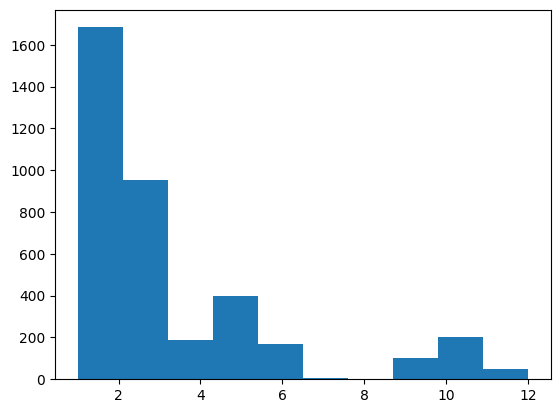

In [16]:
check_dataset_balancing(df)

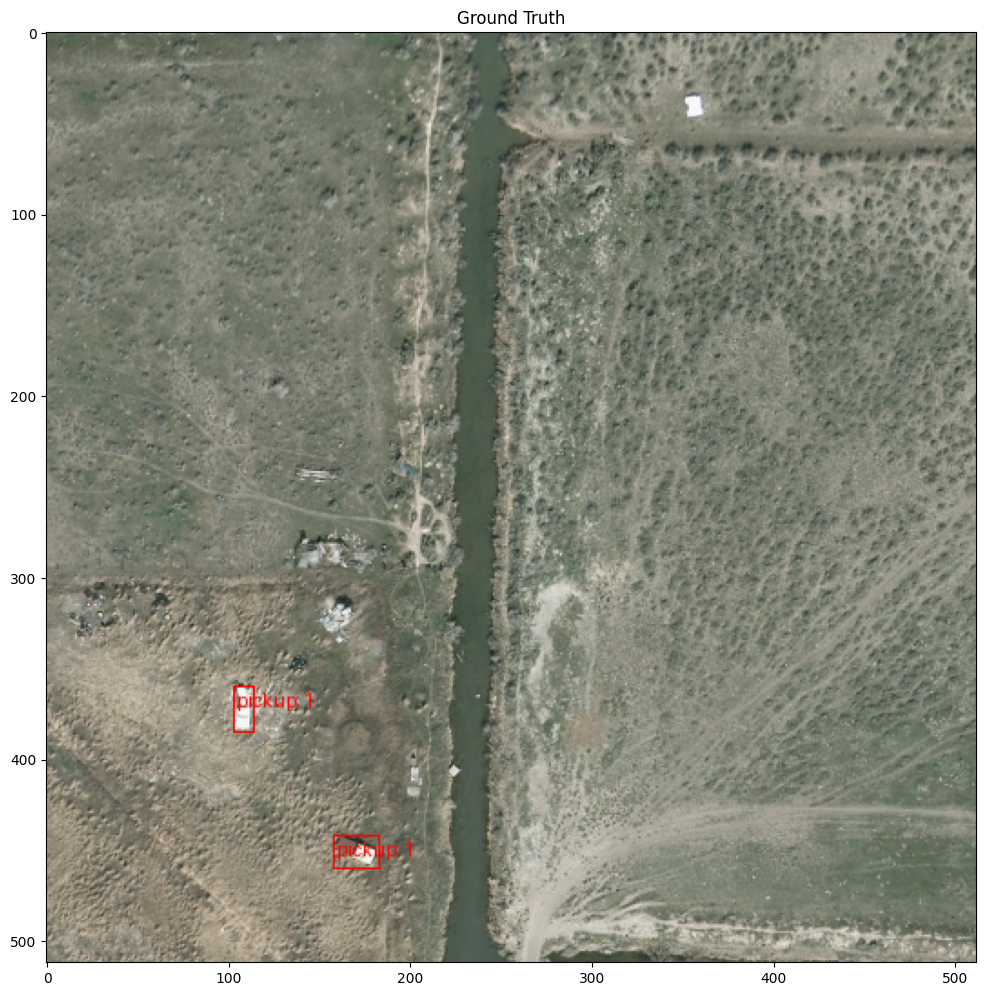

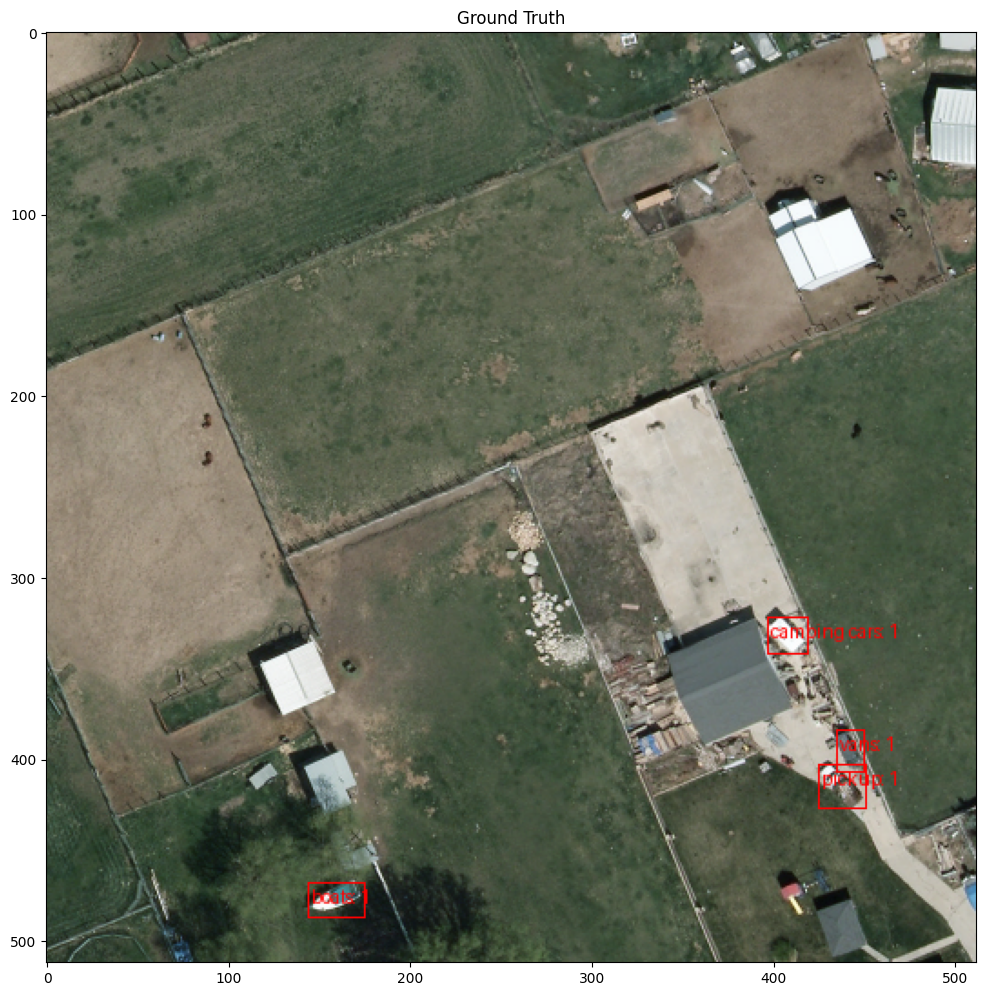

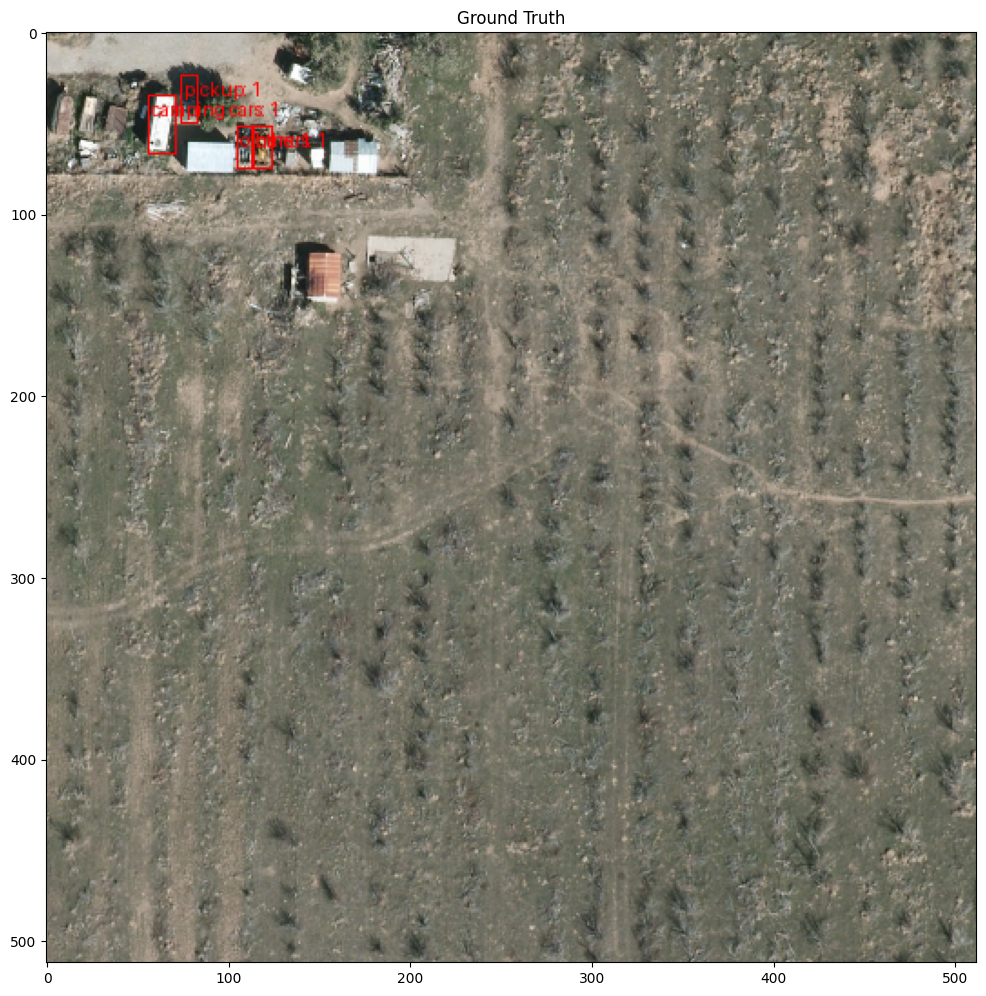

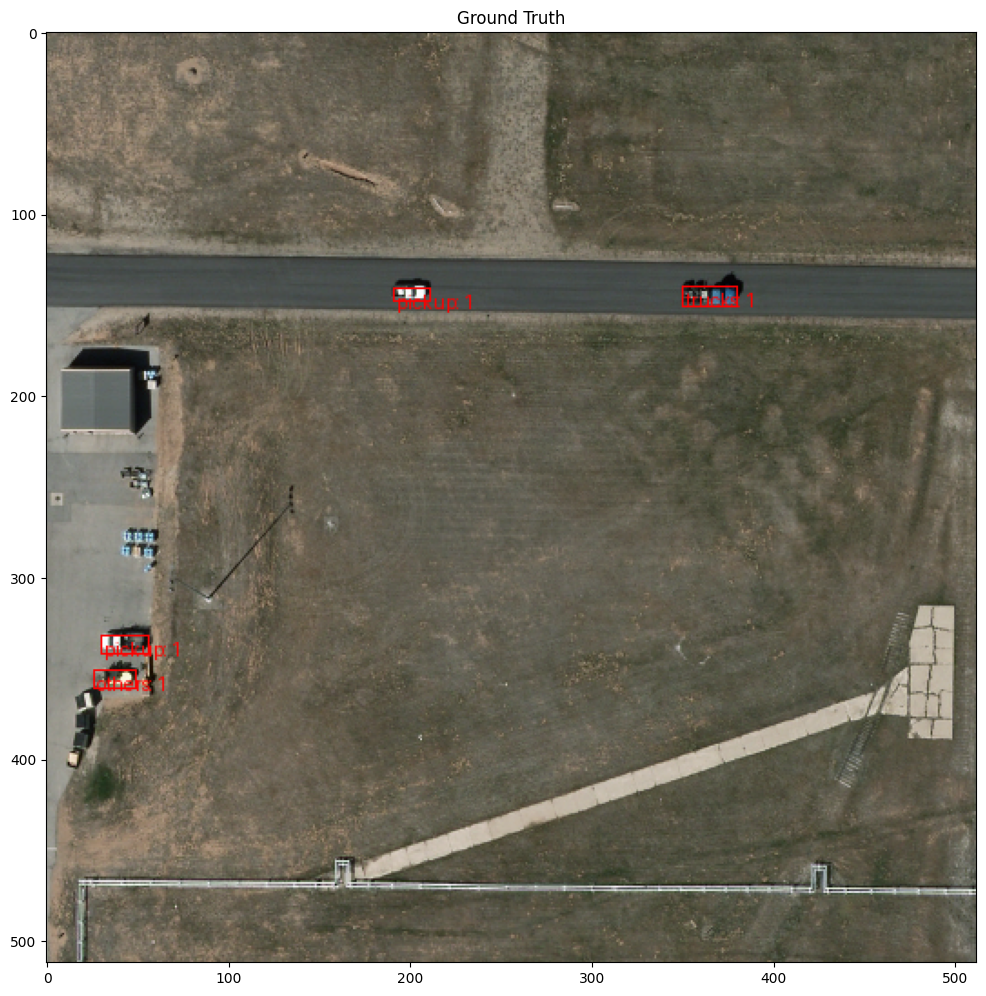

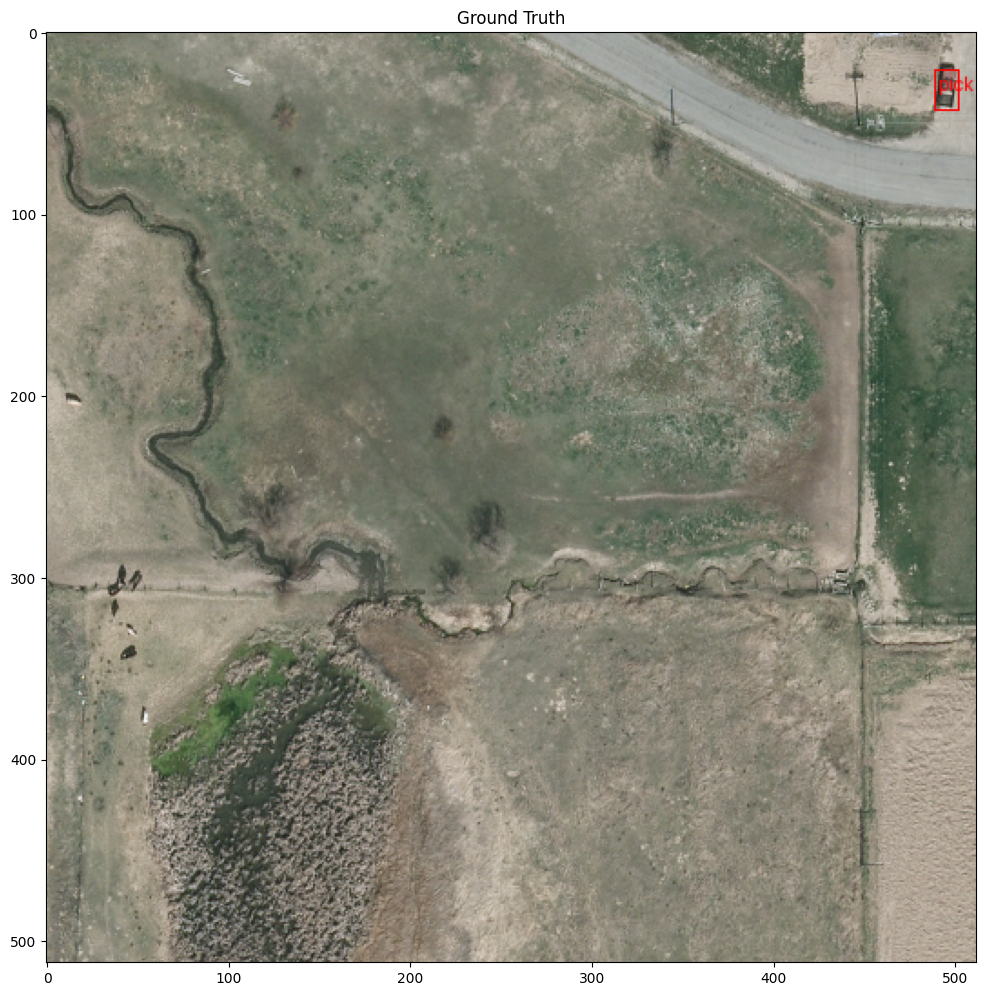

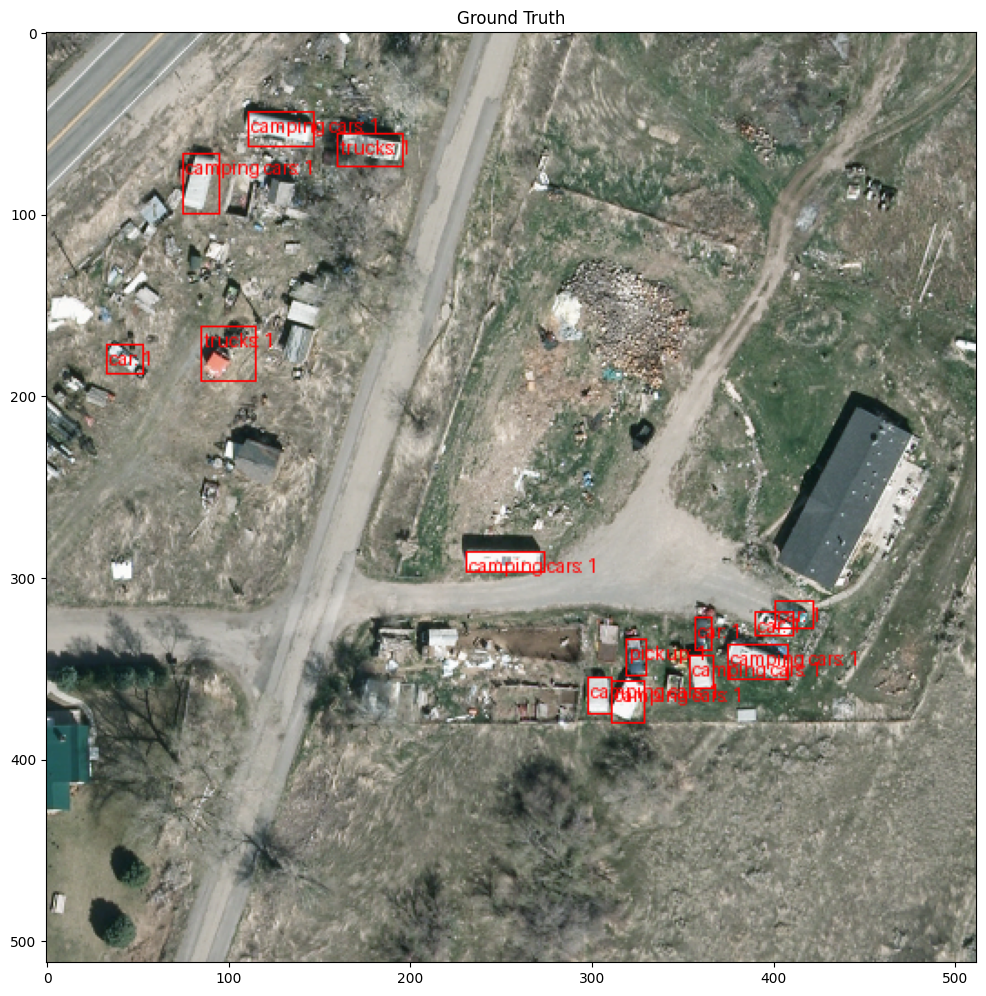

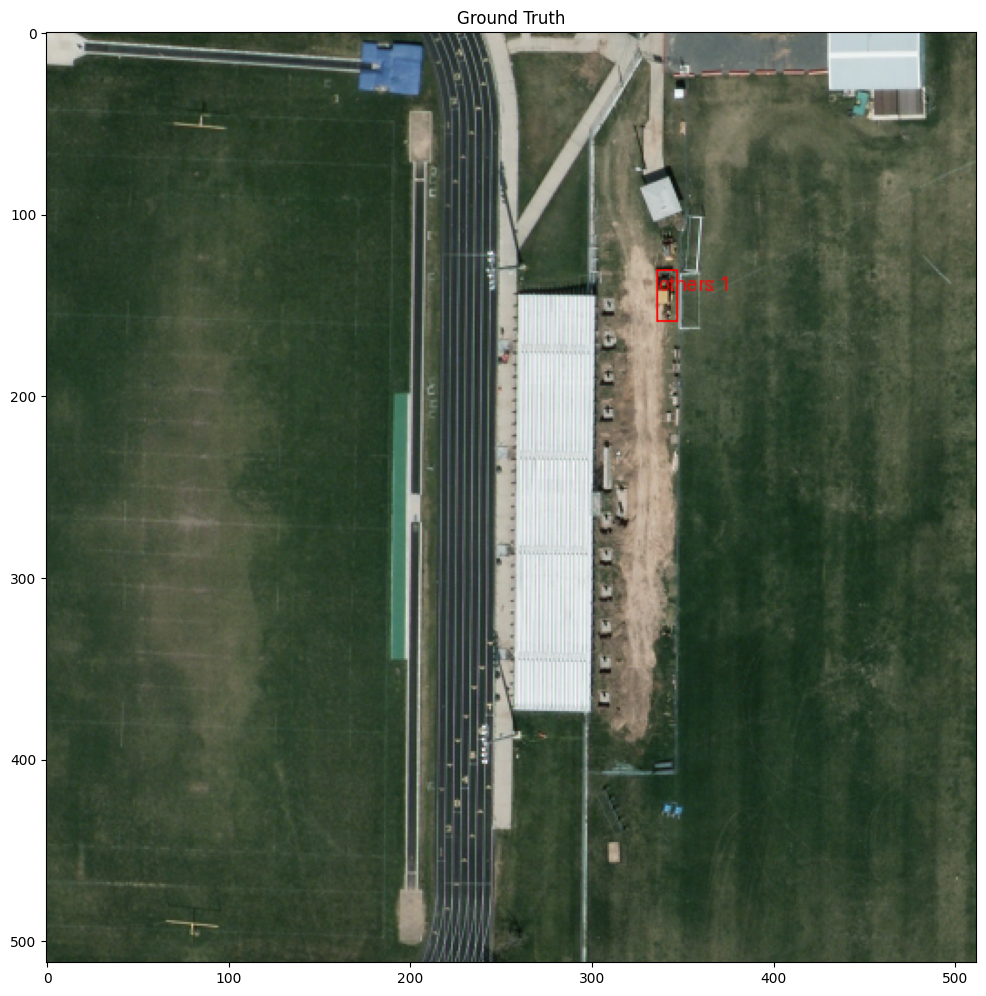

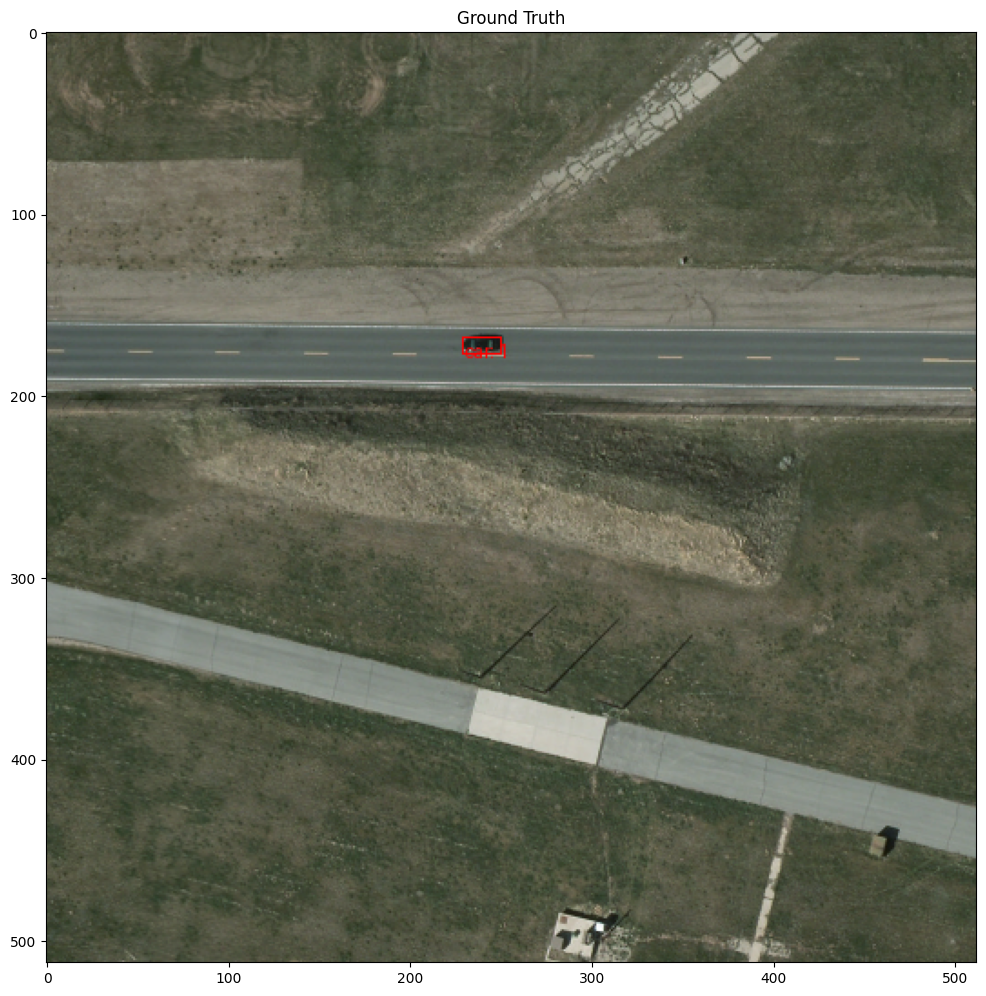

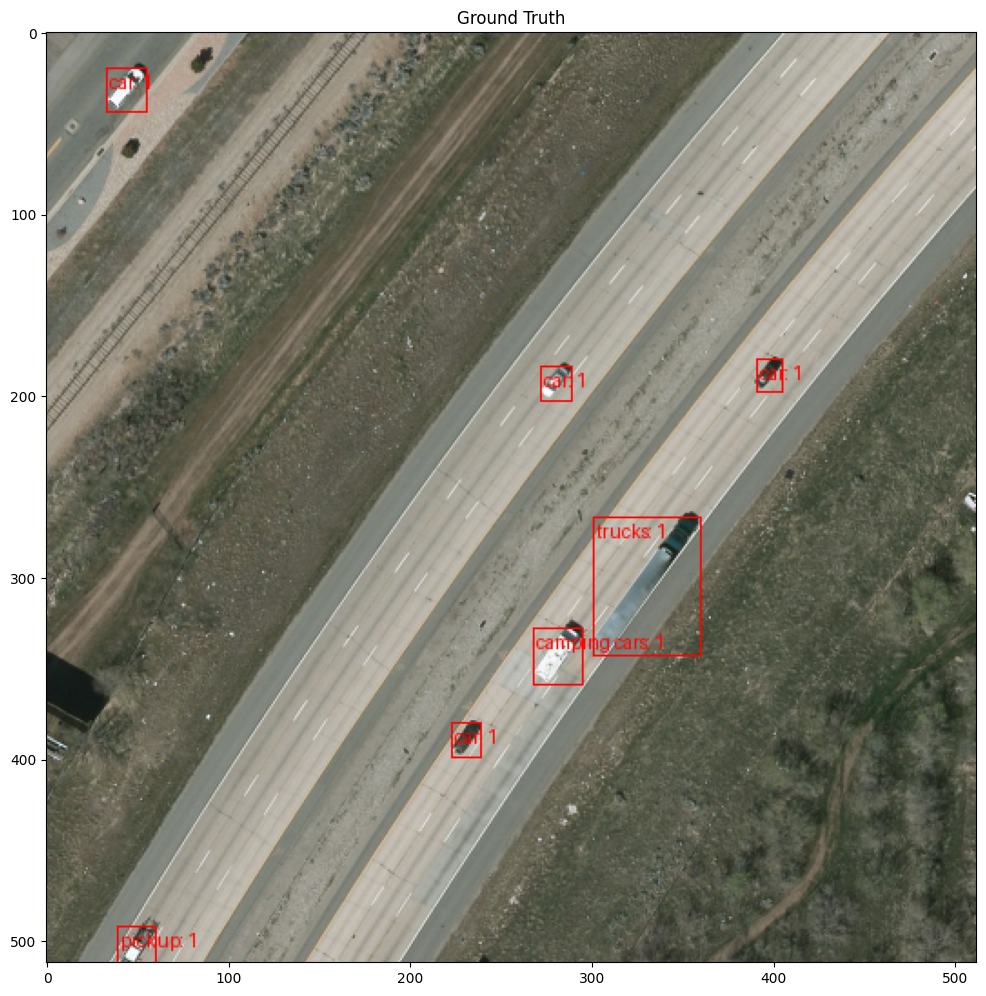

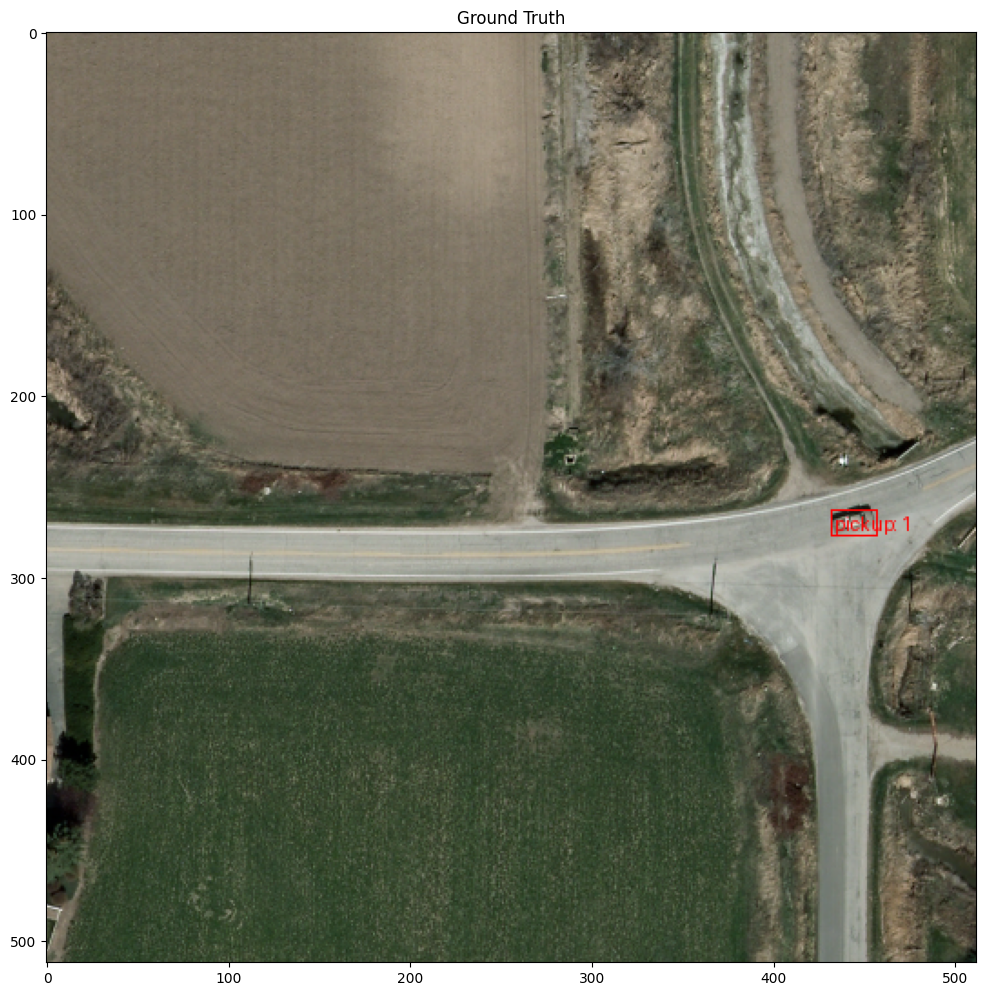

In [17]:
# You can run this code multiple times to get different results
plot_vedai_data(df, 10)

## Dataset Creation

The template provides a wrapper on top of a torch Dataset.

The user is responsible to create their own dataset and load it in PyTorch.

The `Data` class inherits from the `torch.utils.data.Dataset` class. It implements the `__len__` and the `__getitem__` functions. The user must implement the `get_input`, `get_label` and `apply_transform` functions, which define how the input and the labels can be obtained from a `pd.core.frame.DataFrame`

In [18]:
# Import Data from the template
from wcd_project_template.data import Data

In [19]:
class DataObjectDetection(Data):
    def __init__(
            self,
            df,
            config_data: dict,
            transform: Optional[A.Compose] = None,
            img_size: int = 512,
        ):
        super().__init__(df, config_data, transform)
        self.img_size = img_size

    def get_input(self, row):
        """gets the input from the df row

        Returns:
            np.ndarray: the image
        """
        input_path = os.path.join(self.root_dir, row['image'])
        input = cv2.imread(input_path)
        input = cv2.cvtColor(input, cv2.COLOR_BGR2RGB)
        return input

    def get_label(self, row):
        """gets the label from the df row

        Returns:
            Union[np.ndarray, int]: the label
        """
        label_path = os.path.join(self.root_dir, row['label'])
        label = preprocess_label(label_path, self.img_size)
        label = process_label_to_pascal_voc_format(label, self.img_size)
        return label

    def apply_transform(self, input, label):
        """applies the transformation on both the image and the label respectively. For classification, we do not need to apply any transformation on the label.

        Returns:
            Tuple[np.ndarray, int, torch.Tensor]: the transformed images and labels
        """
        transformed = self.transform(image=input, bboxes=label['boxes'], labels=label['labels'])
        input = transformed['image']
        label['boxes'] = torch.Tensor(transformed['bboxes']).to(torch.int64)
        label['boxes'] = tv_tensors.BoundingBoxes(
            label['boxes'],
            format="XYXY",
            canvas_size=(self.img_size, self.img_size))
        label['labels'] = torch.Tensor(transformed['labels']).to(torch.int64)
        return input, label

Define the Transforms

Please note, we also create an inverse_transformation for valid_transformations

In [20]:
# We will use the Albumentations Library for transforms
# https://albumentations.ai/docs/

# Selected Transforms:
# - Resize
# - Horizontal Flip
# - GridDistortion
# - RandomBrightnessContrast
# - GaussNoise
# - Normalize according to Imagenet Mean and Std
# - Convert to Tensor

mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])

# Train Transforms
transforms_train = A.Compose(
    [
        A.Resize(512, 512),
        A.HorizontalFlip(p=0.5),
        A.GridDistortion(p=0.2),
        A.RandomBrightnessContrast((0,0.5),(0,0.5)),
        A.GaussNoise(p=0.8),
        A.Normalize(
            mean=mean.tolist(),
            std=std.tolist(),
        ),
        ToTensorV2(),
    ],
    bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels'])
)

# Validation Transforms
# Note: In validation transforms, we do not add the Horizontal Flip transform
transforms_valid = A.Compose(
    [
        A.Resize(512, 512),
        A.Normalize(
            mean=mean.tolist(),
            std=std.tolist(),
        ),
        ToTensorV2(),
    ],
    bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels'])
)

# Validation Inverse Transforms
# This essentially does an unnormalize on the image.
# We can use this transformation to get the original
# image back after applying the transforms to it
transforms_valid_inverse = A.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

In [21]:
# With reference to: https://github.com/pytorch/vision/blob/main/references/detection/utils.py#L203

def collate_fn(batch):
    return tuple(zip(*batch))

In [22]:
# Training Data config
config_dataset_train = {
    'root_dir': ROOT_DIR,
    'dataloader': {
        'batch_size': 16,
        'shuffle': True,
        'num_workers': 4,
        'collate_fn': collate_fn,
    },
}

# Validation data config
config_dataset_valid = {
    'root_dir': ROOT_DIR,
    'dataloader': {
        'batch_size': 16,
        'shuffle': False,
        'num_workers': 4,
        'collate_fn': collate_fn,
    },
}

Convert the dataset into train, valid and test set

10% test set | 9% valid set | 91% train set

In [23]:
# We use train_test_split from sklearn to connvert the df into train, valid and test sets

df_trainval, df_test = train_test_split(df, test_size=0.1, random_state=19)
df_train, df_valid = train_test_split(df_trainval, test_size=0.1, random_state=19)

print('Train Size   : ', len(df_train))
print('Val Size     : ', len(df_valid))
print('Test Size    : ', len(df_test))

Train Size   :  1008
Val Size     :  113
Test Size    :  125


In [24]:
# Training Data
data_train = DataObjectDetection(
    df_train,
    config_dataset_train,
    transform=transforms_train
)
# Validation Data
data_valid = DataObjectDetection(
    df_valid,
    config_dataset_valid,
    transform=transforms_valid
)
# Testing Data
data_test = DataObjectDetection(
    df_test,
    config_dataset_valid,
    transform=transforms_valid
)

Checking what the data looks like

In [25]:
data_train[0]

(tensor([[[0.9303, 1.0673, 0.9646,  ..., 2.2489, 2.1633, 2.2489],
          [0.7933, 0.9988, 1.0331,  ..., 2.2147, 2.1975, 2.2489],
          [1.0844, 1.1015, 1.1358,  ..., 2.2489, 2.2489, 2.1462],
          ...,
          [1.7009, 2.0263, 2.0605,  ..., 2.2318, 2.2489, 2.1633],
          [1.7180, 1.9064, 2.1804,  ..., 2.1462, 2.2318, 2.2147],
          [1.7009, 1.9749, 1.9064,  ..., 2.2489, 2.2489, 2.2489]],
 
         [[0.8529, 1.0805, 1.0630,  ..., 2.4286, 2.4286, 2.4286],
          [0.9930, 0.9580, 0.9230,  ..., 2.4286, 2.4286, 2.3410],
          [0.8880, 1.0805, 1.0280,  ..., 2.4286, 2.3060, 2.4286],
          ...,
          [1.5882, 1.7633, 1.8859,  ..., 2.4286, 2.4286, 2.4111],
          [1.6057, 1.7108, 1.8683,  ..., 2.2885, 2.3936, 2.4286],
          [1.5707, 1.8683, 1.8683,  ..., 2.3060, 2.4286, 2.4286]],
 
         [[0.7054, 0.8274, 0.6008,  ..., 2.6400, 2.6226, 2.6400],
          [0.7751, 0.7228, 0.7228,  ..., 2.6226, 2.6400, 2.6400],
          [0.9494, 0.8622, 0.9494,  ...,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.039215684..1.0895599].


{'boxes': BoundingBoxes([[260,  88, 273, 112],
               [258, 113, 273, 153],
               [258, 156, 271, 174],
               [250, 430, 261, 450],
               [248, 454, 262, 483]], format=BoundingBoxFormat.XYXY, canvas_size=(512, 512)), 'labels': tensor([ 1,  5, 10,  3,  5]), 'iscrowd': tensor([0, 0, 0, 0, 0])}


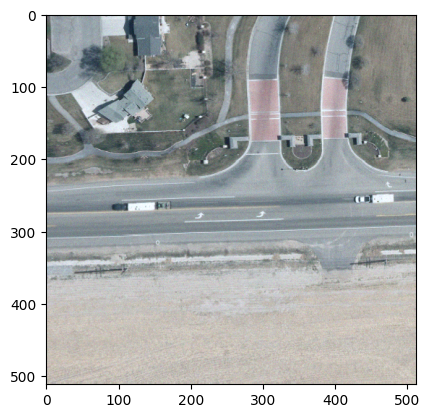

In [26]:
img, label = data_train[0]
img = transforms_valid_inverse(image=img.numpy()*255)['image']
plt.imshow(img.transpose((2,1,0)))
print(label)

## DL Model

---

he template provides a wrapper on top of a torch model. The template provides the usage of 3 different libraries:
- `timm`, `segmentation-models-pytorch` and `torchvision.detection`

For Object Detection Purposes:
- torchvision.detection
    - [Github and Documentation](https://pytorch.org/vision/stable/models.html#object-detection-instance-segmentation-and-person-keypoint-detection)
    - Medium sized list of Object Detection models,
    - Ex: Faster, R-CNN, FCOS, RetinaNet, SSD and SSDlite

In [27]:
# Import Model from the template
from wcd_project_template.model import Model

In [28]:
# You can refer to: https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html
# It is a great resource, it also tells to how you can customize your detection model

from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2, FasterRCNN_ResNet50_FPN_V2_Weights
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# To create a wcd_project_template.model.Model,
# we need a configuration file and a model
# We define the configuration as seen below.
# model_hyperparameters is 

config_model = {
    'model_hyperparameters':{
        'weights': FasterRCNN_ResNet50_FPN_V2_Weights.COCO_V1,
    },
    'weights_path': None,
    'freeze_layers': [],
}
# Create the model from torchvision.models
model_ = fasterrcnn_resnet50_fpn_v2(
    **config_model['model_hyperparameters']
)
# replace the classifier with a new one, that has
# num_classes which is user-defined
num_classes = 13  # 1 class (person) + background
# get number of input features for the classifier
in_features = model_.roi_heads.box_predictor.cls_score.in_features
# replace the pre-trained head with a new one
model_.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
model = Model(model_, config_model)

done loading model


In [29]:
model

Model(
  (model): FasterRCNN(
    (transform): GeneralizedRCNNTransform(
        Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        Resize(min_size=(800,), max_size=1333, mode='bilinear')
    )
    (backbone): BackboneWithFPN(
      (body): IntermediateLayerGetter(
        (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (layer1): Sequential(
          (0): Bottleneck(
            (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): BatchNorm2d(64, eps=1e-05, momentum=0

### Things to note about the torchvision models:

- In training mode, the `__call__` returns the loss of the different regions of the model in a dictionary
- In evaluation mode, the `__call__` returns the actual output of the model (bounding boxes)
- The input is a standard python list of `torch.Tensor` images
- The labels are a standard python list of dictionary with `torch.Tensor` items


The above things affect:
- how the inputs are passed into the model,
- how the input for train mode and eval mode are different,
- how the loss is calculated,

## Model Training

---

The template provides you with a `ModelEngine` class. This class is responsible for supervised model training and evaluation. The code for training or evaluating the model is generally the same for every model. The components that change are the `Loss`, `Metric` and `Optimizer`.
- Loss
    - The loss function can be imported from any library
    - It can also be a custom loss function as seen [here](https://discuss.pytorch.org/t/custom-loss-functions/29387/2)
- Metric
    - Any metric can be used from the library `torchmetrics`.
    - Options for a custom metric are also provided [here](https://lightning.ai/docs/torchmetrics/stable/pages/implement.html)
- Optimizer
    - The optimizer must be from the `torch.optim` module.
    - Any optimizer can be selected
    - Options for a custom optimizer are also provided on the docs

### For Object Detection

- Loss
    - In training mode, the dict loss is returned. We need to aggregate this loss

- Metric
    - Metric calculation is not possible during training as the model does not return the output in training mode
    - Hence the metric in training mode will be None
    - Metric used in evaluation mode is the MAP - Mean Average Precision

- Optimizer
    - We use the standard Adam Optimizer

In [30]:
# Import ModelEngine from the template
from wcd_project_template.model_engine import ModelEngine

In [31]:
# Loss  ------------------------
# This is the Loss Agggregator
# This class aggregates (sums) all the different losses in the dictionary.
# This is the total loss which will be backpropagated through the network
class AggDictLoss:
    def __call__(self, output, label):
        losses = sum(loss for loss in output.values())
        return losses

In [32]:
# Metric ------------------------
# Defined under config

In [33]:
# Optimizer ---------------------
# Defined under config

We need to modify how the input is processed during training and inference mode to satisfy the needs of the torchvision model

In [34]:
class ModelEngineObjectDetection(ModelEngine):
    # During training mode, the input to the model is *(input, label)
    # The model accepts both the input and the label as parameters to the forward call
    def preprocess_data_for_training(self, item):
        input, label = item
        input = list(image.to(self.device) for image in input)
        label = [{k: v.to(self.device) if isinstance(v, torch.Tensor) else v for k, v in t.items()} for t in label]
        return (input, label), label
    
    def preprocess_data_for_prediction(self, item):
        # During training mode, the input to the model is input
        # The model accepts only the input as parameter to the forward call
        input, label = item
        input = list(image.to(self.device) for image in input)
        label = [{k: v.to(self.device) if isinstance(v, torch.Tensor) else v for k, v in t.items()} for t in label]
        return input, label

Create the Model Engine

In [35]:
engine = ModelEngineObjectDetection('cuda')

The Model Engine config consists of the training parameters like `num_epochs`, then it contains sections where you can modify the `criterion`, `metric` and `optimizer`

The `name` parameter is a string corresponding to the import string of the Class. Except for the Optimizer, where it is the optimizer name

The `config` is the kwargs for the Class imported from the `name` parameter



In [36]:
config_training = {
    'num_epochs': 50,
    'optimizer': {
        # Corresponds to the Optimizer present in torch.optim
        # https://pytorch.org/docs/stable/optim.html
        'name': 'Adam',
        # Configuration of the optimizer
        'config': {
            'lr': 0.001,
            'weight_decay': 1e-5,
        },
    },
    'criterion': {
        # The AggDictLoss we defined above
        'name': AggDictLoss,
        # Criterion Configuration
        'config': {},
    },
    'metric': {
        # No Metric since we can not calcualte it
        'name': None,
        # Metric configuration
        'config':{}
    }
}

config_evaluation = {
    'criterion': {
        # No criterion since we do not calcualte any
        'name': None,
        # Criterion Configuration
        'config': {},
    },
    'metric': {
        # Mean Average Precision
        # https://lightning.ai/docs/torchmetrics/stable/detection/mean_average_precision.html
        'name': 'torchmetrics.detection.mean_ap.MeanAveragePrecision',
        # Metric Configuration
        'config':{
            'box_format': 'xyxy'
        }
    }
}

Use the engine with the configuration to train the model

In [37]:
trained_model, training_meta_data = engine.train(
    model = model,
    data_train = data_train,
    data_valid = data_valid,
    config_training = config_training,
    config_evaluation = config_evaluation
)

Total Training Samples:  1008


  2%|▏         | 1/50 [01:09<56:48, 69.57s/it]

Epoch-1: ===========================================
Training: ===========            
Loss: 0.47473200209557065,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.57445146900045 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.04007768, dtype=float32), 'map_50': array(0.11461676, dtype=float32), 'map_75': array(0.00909557, dtype=float32), 'map_small': array(0.04145746, dtype=float32), 'map_medium': array(0., dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.10722981, dtype=float32), 'mar_10': array(0.25143993, dtype=float32), 'mar_100': array(0.26204985, dtype=float32), 'mar_small': array(0.27167684, dtype=float32), 'mar_medium': array(0., dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10], dtype=int32)},            
Time: 3.991787809

  4%|▍         | 2/50 [02:18<55:29, 69.36s/it]

Epoch-2: ===========================================
Training: ===========            
Loss: 0.4071105548313686,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.56912837099935 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.04253357, dtype=float32), 'map_50': array(0.1341147, dtype=float32), 'map_75': array(0.01831486, dtype=float32), 'map_small': array(0.04607097, dtype=float32), 'map_medium': array(0.04551568, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.10290718, dtype=float32), 'mar_10': array(0.23920633, dtype=float32), 'mar_100': array(0.24497142, dtype=float32), 'mar_small': array(0.26262814, dtype=float32), 'mar_medium': array(0.16220239, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10], dtype=int32)},            
Tim

  6%|▌         | 3/50 [03:27<54:11, 69.18s/it]

Epoch-3: ===========================================
Training: ===========            
Loss: 0.38585880635276676,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.34454337099942 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.13021739, dtype=float32), 'map_50': array(0.27552205, dtype=float32), 'map_75': array(0.08875906, dtype=float32), 'map_small': array(0.13016613, dtype=float32), 'map_medium': array(0.2224835, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.2200486, dtype=float32), 'mar_10': array(0.34655342, dtype=float32), 'mar_100': array(0.34759507, dtype=float32), 'mar_small': array(0.3558679, dtype=float32), 'mar_medium': array(0.28363097, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10], dtype=int32)},            
Time

  8%|▊         | 4/50 [04:36<53:02, 69.18s/it]

Epoch-4: ===========================================
Training: ===========            
Loss: 0.34679152591833995,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.54453425300017 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.10610682, dtype=float32), 'map_50': array(0.24983461, dtype=float32), 'map_75': array(0.05371597, dtype=float32), 'map_small': array(0.10599072, dtype=float32), 'map_medium': array(0.14890738, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.16667803, dtype=float32), 'mar_10': array(0.32815292, dtype=float32), 'mar_100': array(0.3331868, dtype=float32), 'mar_small': array(0.3292449, dtype=float32), 'mar_medium': array(0.40952381, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            

 10%|█         | 5/50 [05:45<51:50, 69.13s/it]

Epoch-5: ===========================================
Training: ===========            
Loss: 0.34586186186661794,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.4061902250005 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.19955063, dtype=float32), 'map_50': array(0.3627828, dtype=float32), 'map_75': array(0.20275506, dtype=float32), 'map_small': array(0.20517321, dtype=float32), 'map_medium': array(0.3127791, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.27206522, dtype=float32), 'mar_10': array(0.5064919, dtype=float32), 'mar_100': array(0.5064919, dtype=float32), 'mar_small': array(0.50529003, dtype=float32), 'mar_medium': array(0.5636905, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
Tim

 12%|█▏        | 6/50 [06:55<50:44, 69.19s/it]

Epoch-6: ===========================================
Training: ===========            
Loss: 0.3240210920099228,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.52158832500027 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.14594337, dtype=float32), 'map_50': array(0.29709896, dtype=float32), 'map_75': array(0.11944047, dtype=float32), 'map_small': array(0.14933409, dtype=float32), 'map_medium': array(0.17316714, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.2116477, dtype=float32), 'mar_10': array(0.36925644, dtype=float32), 'mar_100': array(0.38406476, dtype=float32), 'mar_small': array(0.4004398, dtype=float32), 'mar_medium': array(0.23303571, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            


 14%|█▍        | 7/50 [08:04<49:34, 69.17s/it]

Epoch-7: ===========================================
Training: ===========            
Loss: 0.3108855914028864,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.45475056600026 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.17101711, dtype=float32), 'map_50': array(0.32696688, dtype=float32), 'map_75': array(0.15686217, dtype=float32), 'map_small': array(0.17487743, dtype=float32), 'map_medium': array(0.18010038, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.26936978, dtype=float32), 'mar_10': array(0.46375075, dtype=float32), 'mar_100': array(0.46375075, dtype=float32), 'mar_small': array(0.48468298, dtype=float32), 'mar_medium': array(0.24434523, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},           

 16%|█▌        | 8/50 [09:13<48:23, 69.14s/it]

Epoch-8: ===========================================
Training: ===========            
Loss: 0.31396095194513834,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.4293736590007 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.24898091, dtype=float32), 'map_50': array(0.47365513, dtype=float32), 'map_75': array(0.2180369, dtype=float32), 'map_small': array(0.25401482, dtype=float32), 'map_medium': array(0.2716769, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.30778188, dtype=float32), 'mar_10': array(0.48990923, dtype=float32), 'mar_100': array(0.49109456, dtype=float32), 'mar_small': array(0.49711317, dtype=float32), 'mar_medium': array(0.3970238, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
T

 18%|█▊        | 9/50 [10:22<47:16, 69.18s/it]

Epoch-9: ===========================================
Training: ===========            
Loss: 0.3092861719547756,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.64731761600069 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.24283798, dtype=float32), 'map_50': array(0.4905486, dtype=float32), 'map_75': array(0.18481061, dtype=float32), 'map_small': array(0.24756911, dtype=float32), 'map_medium': array(0.30131194, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.31261715, dtype=float32), 'mar_10': array(0.4865136, dtype=float32), 'mar_100': array(0.4865136, dtype=float32), 'mar_small': array(0.49850738, dtype=float32), 'mar_medium': array(0.49345237, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
T

 20%|██        | 10/50 [11:31<46:06, 69.16s/it]

Epoch-10: ===========================================
Training: ===========            
Loss: 0.2964701773155303,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.48761382699922 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3069148, dtype=float32), 'map_50': array(0.5655278, dtype=float32), 'map_75': array(0.31664443, dtype=float32), 'map_small': array(0.3129841, dtype=float32), 'map_medium': array(0.38812754, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.36560974, dtype=float32), 'mar_10': array(0.5387963, dtype=float32), 'mar_100': array(0.5387963, dtype=float32), 'mar_small': array(0.53970367, dtype=float32), 'mar_medium': array(0.56785715, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
Ti

 22%|██▏       | 11/50 [12:41<44:57, 69.16s/it]

Epoch-11: ===========================================
Training: ===========            
Loss: 0.28900267325696494,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.51536792799925 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.2703948, dtype=float32), 'map_50': array(0.5140172, dtype=float32), 'map_75': array(0.24511258, dtype=float32), 'map_small': array(0.27511162, dtype=float32), 'map_medium': array(0.34483758, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3240262, dtype=float32), 'mar_10': array(0.4931655, dtype=float32), 'mar_100': array(0.4931655, dtype=float32), 'mar_small': array(0.5008462, dtype=float32), 'mar_medium': array(0.40803573, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
Ti

 24%|██▍       | 12/50 [13:50<43:46, 69.12s/it]

Epoch-12: ===========================================
Training: ===========            
Loss: 0.2797228831147391,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.40286868300063 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.31928086, dtype=float32), 'map_50': array(0.56383467, dtype=float32), 'map_75': array(0.3255025, dtype=float32), 'map_small': array(0.31974423, dtype=float32), 'map_medium': array(0.3047348, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.38485005, dtype=float32), 'mar_10': array(0.53436965, dtype=float32), 'mar_100': array(0.53436965, dtype=float32), 'mar_small': array(0.5399987, dtype=float32), 'mar_medium': array(0.5190476, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
T

 26%|██▌       | 13/50 [14:59<42:42, 69.26s/it]

Epoch-13: ===========================================
Training: ===========            
Loss: 0.2739758657084571,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.89545747899956 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3000836, dtype=float32), 'map_50': array(0.53629315, dtype=float32), 'map_75': array(0.2763318, dtype=float32), 'map_small': array(0.30572462, dtype=float32), 'map_medium': array(0.20871684, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3883795, dtype=float32), 'mar_10': array(0.54860187, dtype=float32), 'mar_100': array(0.55049735, dtype=float32), 'mar_small': array(0.5604041, dtype=float32), 'mar_medium': array(0.32619047, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
T

 28%|██▊       | 14/50 [16:08<41:32, 69.24s/it]

Epoch-14: ===========================================
Training: ===========            
Loss: 0.2670722793019007,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.57449083600022 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.31772456, dtype=float32), 'map_50': array(0.5785573, dtype=float32), 'map_75': array(0.31998578, dtype=float32), 'map_small': array(0.31422403, dtype=float32), 'map_medium': array(0.29005304, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3842214, dtype=float32), 'mar_10': array(0.525138, dtype=float32), 'mar_100': array(0.525138, dtype=float32), 'mar_small': array(0.5296257, dtype=float32), 'mar_medium': array(0.41636905, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
Time

 30%|███       | 15/50 [17:17<40:22, 69.21s/it]

Epoch-15: ===========================================
Training: ===========            
Loss: 0.26756394500770264,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.49334480599919 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.29260534, dtype=float32), 'map_50': array(0.5467993, dtype=float32), 'map_75': array(0.28876197, dtype=float32), 'map_small': array(0.28306654, dtype=float32), 'map_medium': array(0.3716319, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3269802, dtype=float32), 'mar_10': array(0.46267357, dtype=float32), 'mar_100': array(0.46267357, dtype=float32), 'mar_small': array(0.4539293, dtype=float32), 'mar_medium': array(0.43690476, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            


 32%|███▏      | 16/50 [18:27<39:12, 69.19s/it]

Epoch-16: ===========================================
Training: ===========            
Loss: 0.2635730578312798,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.55665843299994 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.34594685, dtype=float32), 'map_50': array(0.60241497, dtype=float32), 'map_75': array(0.3637457, dtype=float32), 'map_small': array(0.35150206, dtype=float32), 'map_medium': array(0.42157835, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.36786935, dtype=float32), 'mar_10': array(0.5403068, dtype=float32), 'mar_100': array(0.5411689, dtype=float32), 'mar_small': array(0.5481965, dtype=float32), 'mar_medium': array(0.46755952, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},          

 34%|███▍      | 17/50 [19:36<38:05, 69.26s/it]

Epoch-17: ===========================================
Training: ===========            
Loss: 0.2550502305939084,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.79519425000035 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.33505327, dtype=float32), 'map_50': array(0.57322735, dtype=float32), 'map_75': array(0.3860471, dtype=float32), 'map_small': array(0.34267372, dtype=float32), 'map_medium': array(0.39280978, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.38545758, dtype=float32), 'mar_10': array(0.5461464, dtype=float32), 'mar_100': array(0.5482297, dtype=float32), 'mar_small': array(0.551627, dtype=float32), 'mar_medium': array(0.53511906, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},           

 36%|███▌      | 18/50 [20:45<36:56, 69.26s/it]

Epoch-18: ===========================================
Training: ===========            
Loss: 0.2484823257204086,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.62575888399897 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3219365, dtype=float32), 'map_50': array(0.56355584, dtype=float32), 'map_75': array(0.32202336, dtype=float32), 'map_small': array(0.32691872, dtype=float32), 'map_medium': array(0.39115453, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3845167, dtype=float32), 'mar_10': array(0.5487342, dtype=float32), 'mar_100': array(0.5494526, dtype=float32), 'mar_small': array(0.5472616, dtype=float32), 'mar_medium': array(0.56755954, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},           

 38%|███▊      | 19/50 [21:55<35:48, 69.31s/it]

Epoch-19: ===========================================
Training: ===========            
Loss: 0.24804461877497416,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.68357691399979 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.33723038, dtype=float32), 'map_50': array(0.600991, dtype=float32), 'map_75': array(0.37806037, dtype=float32), 'map_small': array(0.34259003, dtype=float32), 'map_medium': array(0.3425005, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.40917414, dtype=float32), 'mar_10': array(0.56086314, dtype=float32), 'mar_100': array(0.56086314, dtype=float32), 'mar_small': array(0.56589824, dtype=float32), 'mar_medium': array(0.5541667, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            


 40%|████      | 20/50 [23:04<34:35, 69.19s/it]

Epoch-20: ===========================================
Training: ===========            
Loss: 0.23856669238635472,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.29652499500116 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.35235593, dtype=float32), 'map_50': array(0.6348871, dtype=float32), 'map_75': array(0.37079638, dtype=float32), 'map_small': array(0.35004485, dtype=float32), 'map_medium': array(0.43523568, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.37838516, dtype=float32), 'mar_10': array(0.5260404, dtype=float32), 'mar_100': array(0.5260404, dtype=float32), 'mar_small': array(0.51877517, dtype=float32), 'mar_medium': array(0.5622024, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},         

 42%|████▏     | 21/50 [24:13<33:26, 69.20s/it]

Epoch-21: ===========================================
Training: ===========            
Loss: 0.2367682662748155,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.5923120360003 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.36544466, dtype=float32), 'map_50': array(0.6407099, dtype=float32), 'map_75': array(0.39588955, dtype=float32), 'map_small': array(0.3687506, dtype=float32), 'map_medium': array(0.35839504, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4220584, dtype=float32), 'mar_10': array(0.5452382, dtype=float32), 'mar_100': array(0.5452382, dtype=float32), 'mar_small': array(0.5432237, dtype=float32), 'mar_medium': array(0.5738095, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},            
T

 44%|████▍     | 22/50 [25:22<32:17, 69.21s/it]

Epoch-22: ===========================================
Training: ===========            
Loss: 0.2419675477440395,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.56661770200117 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.31570777, dtype=float32), 'map_50': array(0.59002537, dtype=float32), 'map_75': array(0.26925495, dtype=float32), 'map_small': array(0.3144778, dtype=float32), 'map_medium': array(0.34688473, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.36125287, dtype=float32), 'mar_10': array(0.48942465, dtype=float32), 'mar_100': array(0.48942465, dtype=float32), 'mar_small': array(0.49033087, dtype=float32), 'mar_medium': array(0.47916666, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},       

 46%|████▌     | 23/50 [26:31<31:09, 69.24s/it]

Epoch-23: ===========================================
Training: ===========            
Loss: 0.241316871747138,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.69327506199988 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.32729247, dtype=float32), 'map_50': array(0.5903279, dtype=float32), 'map_75': array(0.3191501, dtype=float32), 'map_small': array(0.32888824, dtype=float32), 'map_medium': array(0.48734468, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.39042926, dtype=float32), 'mar_10': array(0.5115694, dtype=float32), 'mar_100': array(0.5125392, dtype=float32), 'mar_small': array(0.50657886, dtype=float32), 'mar_medium': array(0.59583336, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},       

 48%|████▊     | 24/50 [27:41<29:59, 69.23s/it]

Epoch-24: ===========================================
Training: ===========            
Loss: 0.2302128528318708,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.60010800199962 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3564093, dtype=float32), 'map_50': array(0.6444935, dtype=float32), 'map_75': array(0.32334173, dtype=float32), 'map_small': array(0.35193035, dtype=float32), 'map_medium': array(0.4500575, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.39385265, dtype=float32), 'mar_10': array(0.52830774, dtype=float32), 'mar_100': array(0.52830774, dtype=float32), 'mar_small': array(0.52706945, dtype=float32), 'mar_medium': array(0.5842262, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},      

 50%|█████     | 25/50 [28:50<28:51, 69.26s/it]

Epoch-25: ===========================================
Training: ===========            
Loss: 0.23407310235594947,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.56566687899976 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3447766, dtype=float32), 'map_50': array(0.6560381, dtype=float32), 'map_75': array(0.32625553, dtype=float32), 'map_small': array(0.3453816, dtype=float32), 'map_medium': array(0.3515483, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3667671, dtype=float32), 'mar_10': array(0.5031597, dtype=float32), 'mar_100': array(0.5031597, dtype=float32), 'mar_small': array(0.5014849, dtype=float32), 'mar_medium': array(0.41369048, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  9, 10, 12], dtype=int32)},            
Time

 52%|█████▏    | 26/50 [29:59<27:42, 69.25s/it]

Epoch-26: ===========================================
Training: ===========            
Loss: 0.22499083159934907,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.60218628199982 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.36830074, dtype=float32), 'map_50': array(0.6502166, dtype=float32), 'map_75': array(0.37963417, dtype=float32), 'map_small': array(0.37591955, dtype=float32), 'map_medium': array(0.37246948, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.38548264, dtype=float32), 'mar_10': array(0.528815, dtype=float32), 'mar_100': array(0.52967703, dtype=float32), 'mar_small': array(0.53524196, dtype=float32), 'mar_medium': array(0.48333332, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},        

 54%|█████▍    | 27/50 [31:08<26:32, 69.24s/it]

Epoch-27: ===========================================
Training: ===========            
Loss: 0.2195076457564793,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.59635755999989 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.33252576, dtype=float32), 'map_50': array(0.58500785, dtype=float32), 'map_75': array(0.34207466, dtype=float32), 'map_small': array(0.3293234, dtype=float32), 'map_medium': array(0.36841792, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.38925353, dtype=float32), 'mar_10': array(0.50064194, dtype=float32), 'mar_100': array(0.50064194, dtype=float32), 'mar_small': array(0.4790928, dtype=float32), 'mar_medium': array(0.5970238, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},     

 56%|█████▌    | 28/50 [32:18<25:23, 69.23s/it]

Epoch-28: ===========================================
Training: ===========            
Loss: 0.21684129547978204,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.54937774800055 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.33096555, dtype=float32), 'map_50': array(0.5772203, dtype=float32), 'map_75': array(0.3383861, dtype=float32), 'map_small': array(0.32572344, dtype=float32), 'map_medium': array(0.5243544, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.38382295, dtype=float32), 'mar_10': array(0.5402183, dtype=float32), 'mar_100': array(0.5402183, dtype=float32), 'mar_small': array(0.5316101, dtype=float32), 'mar_medium': array(0.66934526, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},       

 58%|█████▊    | 29/50 [33:27<24:14, 69.24s/it]

Epoch-29: ===========================================
Training: ===========            
Loss: 0.21632620029979283,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.63217958199857 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.38721395, dtype=float32), 'map_50': array(0.66507065, dtype=float32), 'map_75': array(0.41143024, dtype=float32), 'map_small': array(0.38458073, dtype=float32), 'map_medium': array(0.35896552, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4349044, dtype=float32), 'mar_10': array(0.5443398, dtype=float32), 'mar_100': array(0.5443398, dtype=float32), 'mar_small': array(0.54103184, dtype=float32), 'mar_medium': array(0.42976192, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},        

 60%|██████    | 30/50 [34:36<23:04, 69.22s/it]

Epoch-30: ===========================================
Training: ===========            
Loss: 0.21387832221530734,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.5462597859987 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.39760238, dtype=float32), 'map_50': array(0.6769942, dtype=float32), 'map_75': array(0.4467344, dtype=float32), 'map_small': array(0.3987625, dtype=float32), 'map_medium': array(0.5157677, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4024726, dtype=float32), 'mar_10': array(0.5252276, dtype=float32), 'mar_100': array(0.5252276, dtype=float32), 'mar_small': array(0.5293222, dtype=float32), 'mar_medium': array(0.55714285, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  9, 10, 12], dtype=int32)},            
T

 62%|██████▏   | 31/50 [35:45<21:54, 69.20s/it]

Epoch-31: ===========================================
Training: ===========            
Loss: 0.21151434559197652,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.53219956099929 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3924638, dtype=float32), 'map_50': array(0.6728858, dtype=float32), 'map_75': array(0.42779082, dtype=float32), 'map_small': array(0.38847998, dtype=float32), 'map_medium': array(0.40857816, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4157628, dtype=float32), 'mar_10': array(0.5535241, dtype=float32), 'mar_100': array(0.5545658, dtype=float32), 'mar_small': array(0.5507004, dtype=float32), 'mar_medium': array(0.5404762, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},        

 64%|██████▍   | 32/50 [36:54<20:45, 69.20s/it]

Epoch-32: ===========================================
Training: ===========            
Loss: 0.20663015615372432,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.45825045799938 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.36395115, dtype=float32), 'map_50': array(0.6305978, dtype=float32), 'map_75': array(0.3778973, dtype=float32), 'map_small': array(0.3643435, dtype=float32), 'map_medium': array(0.42673656, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.39174554, dtype=float32), 'mar_10': array(0.5295116, dtype=float32), 'mar_100': array(0.5301581, dtype=float32), 'mar_small': array(0.53528625, dtype=float32), 'mar_medium': array(0.52648807, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},      

 66%|██████▌   | 33/50 [38:04<19:36, 69.22s/it]

Epoch-33: ===========================================
Training: ===========            
Loss: 0.20774422420395744,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.62067519899938 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.41420883, dtype=float32), 'map_50': array(0.6973852, dtype=float32), 'map_75': array(0.4361602, dtype=float32), 'map_small': array(0.41939637, dtype=float32), 'map_medium': array(0.42490608, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.43096736, dtype=float32), 'mar_10': array(0.56470346, dtype=float32), 'mar_100': array(0.56502676, dtype=float32), 'mar_small': array(0.57049924, dtype=float32), 'mar_medium': array(0.53363097, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},   

 68%|██████▊   | 34/50 [39:13<18:27, 69.22s/it]

Epoch-34: ===========================================
Training: ===========            
Loss: 0.2046015773500715,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.56306830999893 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.34527233, dtype=float32), 'map_50': array(0.5927983, dtype=float32), 'map_75': array(0.36164647, dtype=float32), 'map_small': array(0.34626898, dtype=float32), 'map_medium': array(0.2448842, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3799921, dtype=float32), 'mar_10': array(0.53204083, dtype=float32), 'mar_100': array(0.53204083, dtype=float32), 'mar_small': array(0.54134643, dtype=float32), 'mar_medium': array(0.5104167, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},          

 70%|███████   | 35/50 [40:22<17:18, 69.22s/it]

Epoch-35: ===========================================
Training: ===========            
Loss: 0.20630595123484022,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.59236016000068 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.40121955, dtype=float32), 'map_50': array(0.69135946, dtype=float32), 'map_75': array(0.42869788, dtype=float32), 'map_small': array(0.4024857, dtype=float32), 'map_medium': array(0.42787573, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.41519135, dtype=float32), 'mar_10': array(0.5239164, dtype=float32), 'mar_100': array(0.5239164, dtype=float32), 'mar_small': array(0.52982414, dtype=float32), 'mar_medium': array(0.52589285, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},    

 72%|███████▏  | 36/50 [41:31<16:09, 69.21s/it]

Epoch-36: ===========================================
Training: ===========            
Loss: 0.20704040002255214,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.58545797899933 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3802148, dtype=float32), 'map_50': array(0.65552443, dtype=float32), 'map_75': array(0.40988225, dtype=float32), 'map_small': array(0.37709495, dtype=float32), 'map_medium': array(0.48979846, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.37961972, dtype=float32), 'mar_10': array(0.5106465, dtype=float32), 'mar_100': array(0.51118535, dtype=float32), 'mar_small': array(0.5047223, dtype=float32), 'mar_medium': array(0.583631, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},          

 74%|███████▍  | 37/50 [42:40<14:59, 69.17s/it]

Epoch-37: ===========================================
Training: ===========            
Loss: 0.1945750449621488,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.42500115599978 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.32560936, dtype=float32), 'map_50': array(0.57546645, dtype=float32), 'map_75': array(0.36049134, dtype=float32), 'map_small': array(0.32883248, dtype=float32), 'map_medium': array(0.4472246, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3556272, dtype=float32), 'mar_10': array(0.46999317, dtype=float32), 'mar_100': array(0.47063974, dtype=float32), 'mar_small': array(0.4713716, dtype=float32), 'mar_medium': array(0.5419643, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  9, 10], dtype=int32)},            
T

 76%|███████▌  | 38/50 [43:49<13:49, 69.14s/it]

Epoch-38: ===========================================
Training: ===========            
Loss: 0.19516870615974305,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.4377244999996 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3732978, dtype=float32), 'map_50': array(0.64293694, dtype=float32), 'map_75': array(0.4099813, dtype=float32), 'map_small': array(0.3694986, dtype=float32), 'map_medium': array(0.51996267, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.41273698, dtype=float32), 'mar_10': array(0.5452262, dtype=float32), 'mar_100': array(0.5460883, dtype=float32), 'mar_small': array(0.53672063, dtype=float32), 'mar_medium': array(0.6, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},            
T

 78%|███████▊  | 39/50 [44:59<12:40, 69.15s/it]

Epoch-39: ===========================================
Training: ===========            
Loss: 0.19547501667624428,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.5423758729994 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.37834, dtype=float32), 'map_50': array(0.66431355, dtype=float32), 'map_75': array(0.394222, dtype=float32), 'map_small': array(0.38168916, dtype=float32), 'map_medium': array(0.2858857, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4018731, dtype=float32), 'mar_10': array(0.5355177, dtype=float32), 'mar_100': array(0.5355177, dtype=float32), 'mar_small': array(0.53771126, dtype=float32), 'mar_medium': array(0.5598214, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},            
Tim

 80%|████████  | 40/50 [46:08<11:31, 69.17s/it]

Epoch-40: ===========================================
Training: ===========            
Loss: 0.19531385872572188,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.50681992699901 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.38115785, dtype=float32), 'map_50': array(0.67066777, dtype=float32), 'map_75': array(0.4027299, dtype=float32), 'map_small': array(0.38207307, dtype=float32), 'map_medium': array(0.49815416, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.387243, dtype=float32), 'mar_10': array(0.50359935, dtype=float32), 'mar_100': array(0.5038149, dtype=float32), 'mar_small': array(0.5039838, dtype=float32), 'mar_medium': array(0.5497024, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},           

 82%|████████▏ | 41/50 [47:17<10:22, 69.15s/it]

Epoch-41: ===========================================
Training: ===========            
Loss: 0.190676940220689,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.4731458089991 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.4208833, dtype=float32), 'map_50': array(0.71391714, dtype=float32), 'map_75': array(0.44745147, dtype=float32), 'map_small': array(0.42586002, dtype=float32), 'map_medium': array(0.4696681, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.41360086, dtype=float32), 'mar_10': array(0.5442468, dtype=float32), 'mar_100': array(0.5447856, dtype=float32), 'mar_small': array(0.54496205, dtype=float32), 'mar_medium': array(0.55833334, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},        

 84%|████████▍ | 42/50 [48:26<09:12, 69.10s/it]

Epoch-42: ===========================================
Training: ===========            
Loss: 0.18950010221155864,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.39047268099966 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.40142578, dtype=float32), 'map_50': array(0.6978025, dtype=float32), 'map_75': array(0.42112347, dtype=float32), 'map_small': array(0.39439932, dtype=float32), 'map_medium': array(0.510094, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3906247, dtype=float32), 'mar_10': array(0.51843107, dtype=float32), 'mar_100': array(0.5188621, dtype=float32), 'mar_small': array(0.5080468, dtype=float32), 'mar_medium': array(0.5797619, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},            

 86%|████████▌ | 43/50 [49:35<08:03, 69.03s/it]

Epoch-43: ===========================================
Training: ===========            
Loss: 0.17973717349389243,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.2908774030002 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.37301436, dtype=float32), 'map_50': array(0.66793865, dtype=float32), 'map_75': array(0.39610097, dtype=float32), 'map_small': array(0.37852457, dtype=float32), 'map_medium': array(0.41922307, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.39731014, dtype=float32), 'mar_10': array(0.4878566, dtype=float32), 'mar_100': array(0.48850313, dtype=float32), 'mar_small': array(0.48078707, dtype=float32), 'mar_medium': array(0.52678573, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},   

 88%|████████▊ | 44/50 [50:44<06:54, 69.03s/it]

Epoch-44: ===========================================
Training: ===========            
Loss: 0.17895640752145223,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.40550283300036 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.40616983, dtype=float32), 'map_50': array(0.6728688, dtype=float32), 'map_75': array(0.48100558, dtype=float32), 'map_small': array(0.40701044, dtype=float32), 'map_medium': array(0.527126, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.41582125, dtype=float32), 'mar_10': array(0.5401336, dtype=float32), 'mar_100': array(0.5404569, dtype=float32), 'mar_small': array(0.5432741, dtype=float32), 'mar_medium': array(0.5848214, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},            

 90%|█████████ | 45/50 [51:53<05:45, 69.05s/it]

Epoch-45: ===========================================
Training: ===========            
Loss: 0.18591839051435863,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.49367555499884 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.39538044, dtype=float32), 'map_50': array(0.674001, dtype=float32), 'map_75': array(0.39916506, dtype=float32), 'map_small': array(0.39063016, dtype=float32), 'map_medium': array(0.5345627, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.41304284, dtype=float32), 'mar_10': array(0.5245699, dtype=float32), 'mar_100': array(0.5245699, dtype=float32), 'mar_small': array(0.51302147, dtype=float32), 'mar_medium': array(0.66011906, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},      

 92%|█████████▏| 46/50 [53:02<04:36, 69.05s/it]

Epoch-46: ===========================================
Training: ===========            
Loss: 0.18019557200253955,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.41003278700009 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.35523438, dtype=float32), 'map_50': array(0.62364244, dtype=float32), 'map_75': array(0.4055184, dtype=float32), 'map_small': array(0.36010027, dtype=float32), 'map_medium': array(0.4876213, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.39454722, dtype=float32), 'mar_10': array(0.5133893, dtype=float32), 'mar_100': array(0.5133893, dtype=float32), 'mar_small': array(0.50661427, dtype=float32), 'mar_medium': array(0.5934524, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},      

 94%|█████████▍| 47/50 [54:11<03:27, 69.05s/it]

Epoch-47: ===========================================
Training: ===========            
Loss: 0.1798501947805995,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.44898502099932 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.37480146, dtype=float32), 'map_50': array(0.65446115, dtype=float32), 'map_75': array(0.38714558, dtype=float32), 'map_small': array(0.37878954, dtype=float32), 'map_medium': array(0.51937294, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.3997969, dtype=float32), 'mar_10': array(0.5149876, dtype=float32), 'mar_100': array(0.5149876, dtype=float32), 'mar_small': array(0.5189311, dtype=float32), 'mar_medium': array(0.5375, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},          

 96%|█████████▌| 48/50 [55:20<02:18, 69.14s/it]

Epoch-48: ===========================================
Training: ===========            
Loss: 0.18139354092261148,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.6119885320004 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.36000288, dtype=float32), 'map_50': array(0.59576553, dtype=float32), 'map_75': array(0.40702853, dtype=float32), 'map_small': array(0.35605204, dtype=float32), 'map_medium': array(0.4460348, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4117748, dtype=float32), 'mar_10': array(0.53950614, dtype=float32), 'mar_100': array(0.53950614, dtype=float32), 'mar_small': array(0.52839077, dtype=float32), 'mar_medium': array(0.6026786, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 12], dtype=int32)},         

 98%|█████████▊| 49/50 [56:30<01:09, 69.20s/it]

Epoch-49: ===========================================
Training: ===========            
Loss: 0.18400244225585272,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.67226766000022 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.36827216, dtype=float32), 'map_50': array(0.6388553, dtype=float32), 'map_75': array(0.36626786, dtype=float32), 'map_small': array(0.37183148, dtype=float32), 'map_medium': array(0.31198394, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4075248, dtype=float32), 'mar_10': array(0.528812, dtype=float32), 'mar_100': array(0.52924305, dtype=float32), 'mar_small': array(0.5323966, dtype=float32), 'mar_medium': array(0.3919643, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},       

100%|██████████| 50/50 [57:39<00:00, 69.19s/it]

Epoch-50: ===========================================
Training: ===========            
Loss: 0.17933456339533366,            
Metrics: {<class 'NoneType'>: array([0.], dtype=float32)},            
Time: 65.60031267500017 seconds
Validation: =========            
Loss = [0.],            
Metrics: {'map': array(0.3975316, dtype=float32), 'map_50': array(0.661602, dtype=float32), 'map_75': array(0.43125856, dtype=float32), 'map_small': array(0.39322397, dtype=float32), 'map_medium': array(0.45270804, dtype=float32), 'map_large': array(-1., dtype=float32), 'mar_1': array(0.4106774, dtype=float32), 'mar_10': array(0.5379711, dtype=float32), 'mar_100': array(0.5385099, dtype=float32), 'mar_small': array(0.5277205, dtype=float32), 'mar_medium': array(0.6529762, dtype=float32), 'mar_large': array(-1., dtype=float32), 'map_per_class': array(-1., dtype=float32), 'mar_100_per_class': array(-1., dtype=float32), 'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)},         

Save the trained model

In [38]:
torch.save(trained_model, 'object_detection_model.pth')

Load a previously trained model

In [39]:
trained_model = torch.load('object_detection_model.pth')

/tmp/ipykernel_86942/1651587625.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  trained_model = torch.load('object_detection_model.pth')


## Model Evaluation

---

The model can be evaluated similar to the training method. By specifying the trained_model, data_test and the config_evaluation

In [40]:
engine.evaluate(
    model = trained_model,
    data_valid = data_test,
    config_evaluation = config_evaluation
)

(array([0.], dtype=float32),
 {'map': array(0.3673719, dtype=float32),
  'map_50': array(0.6624665, dtype=float32),
  'map_75': array(0.38598797, dtype=float32),
  'map_small': array(0.34622484, dtype=float32),
  'map_medium': array(0.4371055, dtype=float32),
  'map_large': array(-1., dtype=float32),
  'mar_1': array(0.3213443, dtype=float32),
  'mar_10': array(0.51415986, dtype=float32),
  'mar_100': array(0.5142591, dtype=float32),
  'mar_small': array(0.500117, dtype=float32),
  'mar_medium': array(0.5257143, dtype=float32),
  'mar_large': array(-1., dtype=float32),
  'map_per_class': array(-1., dtype=float32),
  'mar_100_per_class': array(-1., dtype=float32),
  'classes': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 12], dtype=int32)})

## Visualize The Predictions

---

In [41]:
# Make predictions on the test set
outputs, labels, inputs = engine._make_predictions(trained_model, data_test.get_dataloader(), return_input=True)

In [45]:
# Helper Functions for visualization
from torchvision.utils import draw_bounding_boxes
from torchvision.ops import nms

def visualize_predictions(inputs, outputs, labels, num_images=10):
    for i in range(num_images):
        # Select random idx
        random_idx = np.random.randint(0, len(inputs))
        input_idx = inputs[random_idx]
        output_idx = outputs[random_idx]
        label_idx = labels[random_idx]
        # Inverse transform the image
        image = torch.Tensor(transforms_valid_inverse(image=input_idx.cpu().numpy()*255)['image'])
        # Get the output labels
        output_labels = np.array([f"{label_dict[label.item()]}: {score:.3f}" for label, score in zip(output_idx["labels"], output_idx["scores"])])
        output_boxes = output_idx["boxes"].long()
        # Apply Non Max Suppression on the bounding boxes
        nms_boxes = nms(output_idx["boxes"], output_idx["scores"], 0.3).to('cpu')
        # Select the non max suppressed boxes and labels
        output_boxes = output_boxes[nms_boxes]
        output_labels = output_labels[nms_boxes]
        # If there is only a single labels, convert it into array
        if isinstance(output_labels, np.str_):
            output_labels = [output_labels]
        # Get the predicted image
        output_image = draw_bounding_boxes(image, output_boxes, output_labels, colors="red")

        # Get the Ground truth image
        labels_labels = np.array([f"{label_dict[label.item()]}: 1" for label in label_idx["labels"]])
        labels_boxes = label_idx["boxes"].long()
        labels_image = draw_bounding_boxes(image, labels_boxes, labels_labels, colors="red")

        # Plot both the images in 2 columns
        fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(16,42))
        ax1.imshow(output_image.permute(1, 2, 0))
        ax2.imshow(labels_image.permute(1, 2, 0))
        ax1.set_title('Prediction')
        ax2.set_title('Ground Truth')
                
        plt.show()

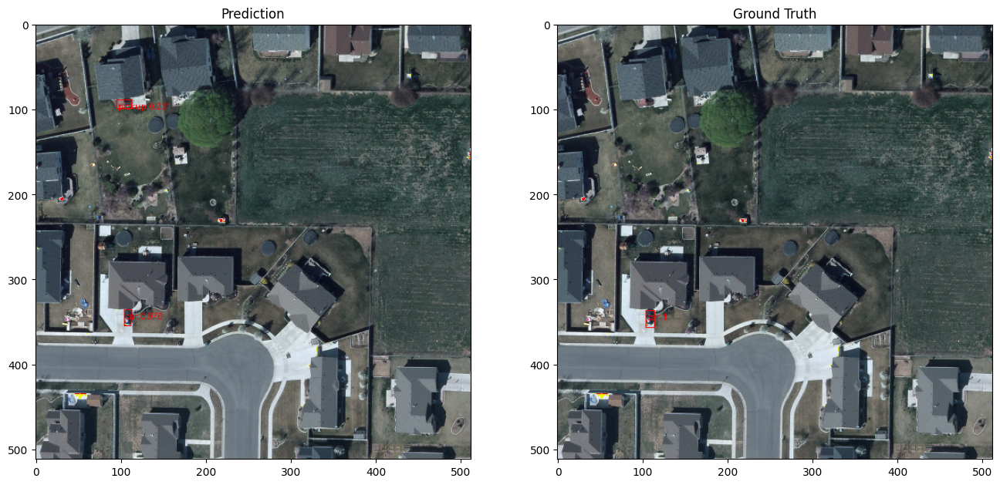

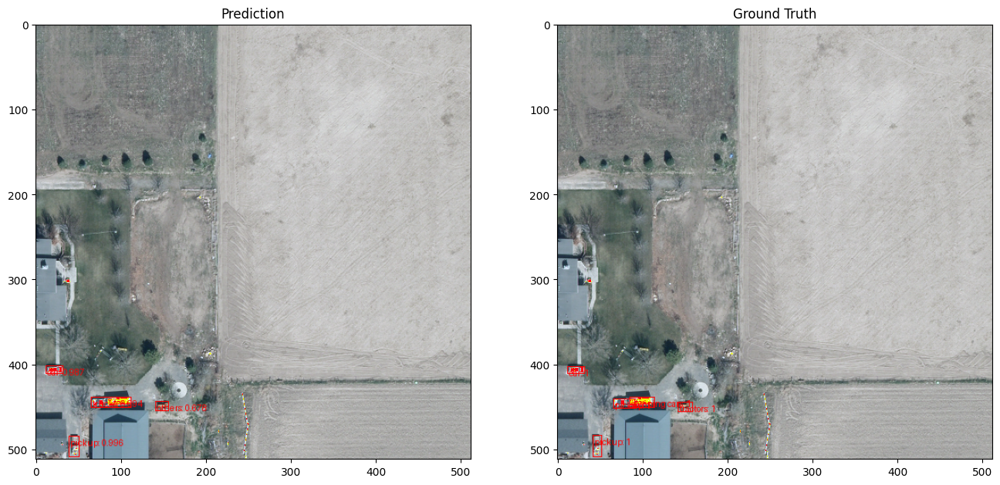

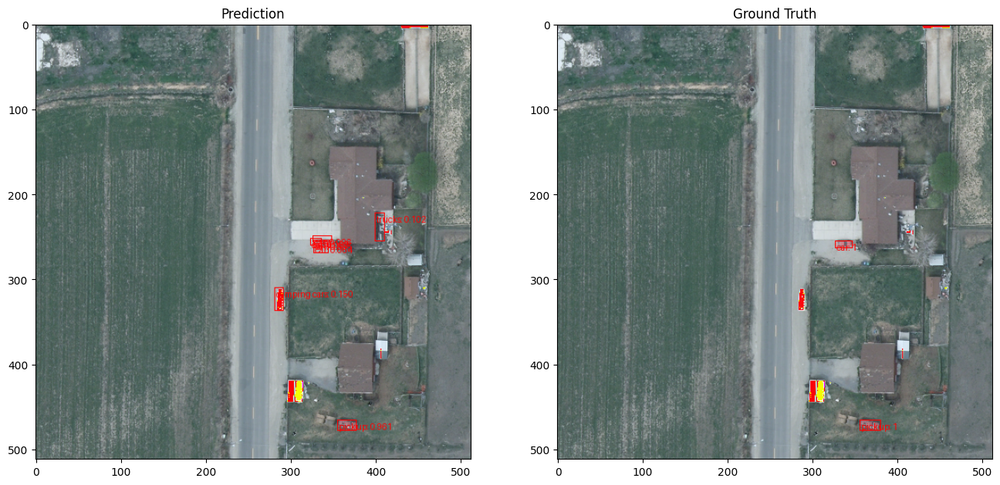

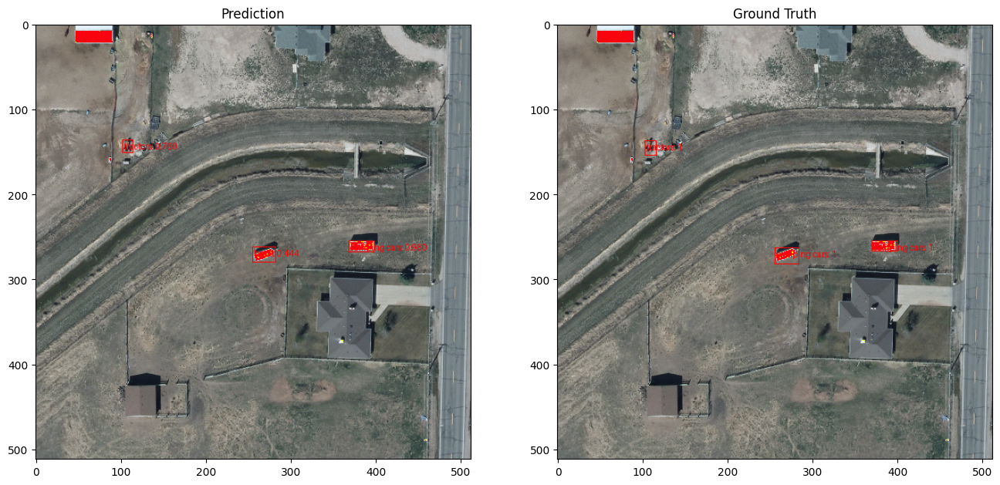

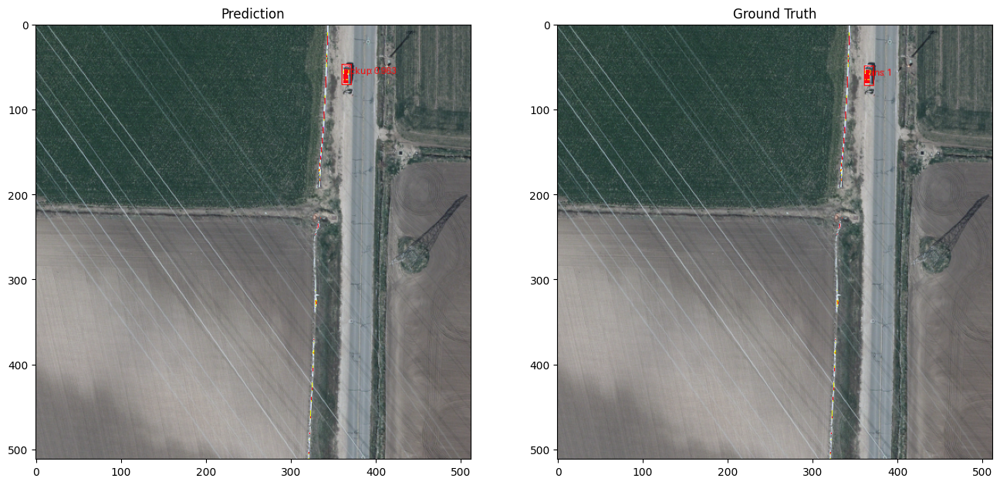

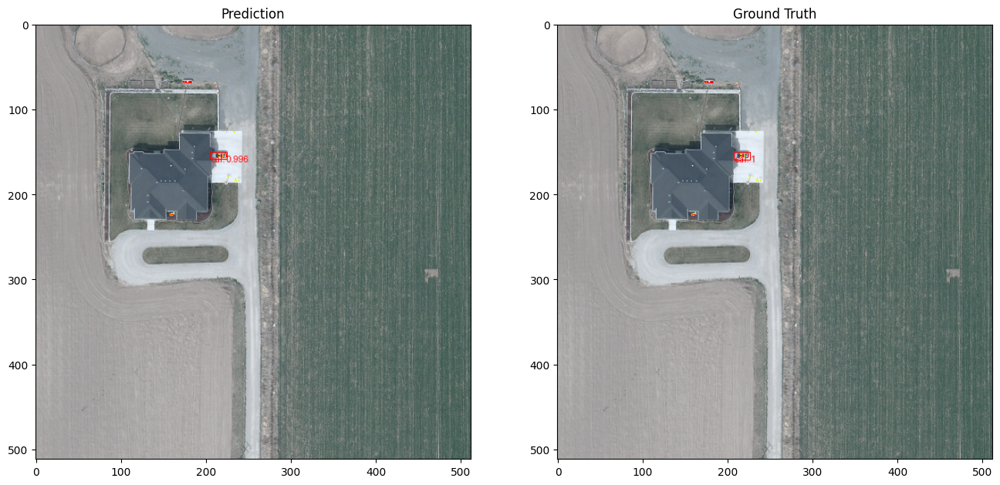

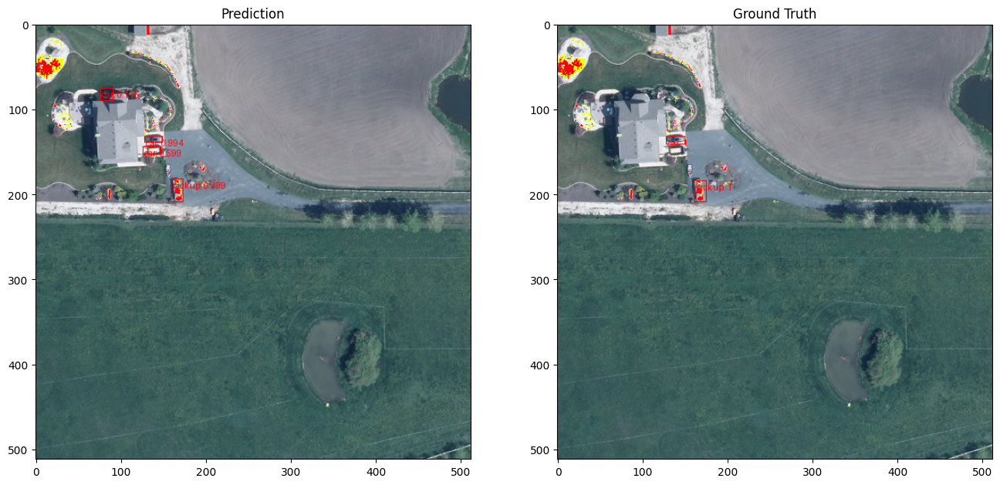

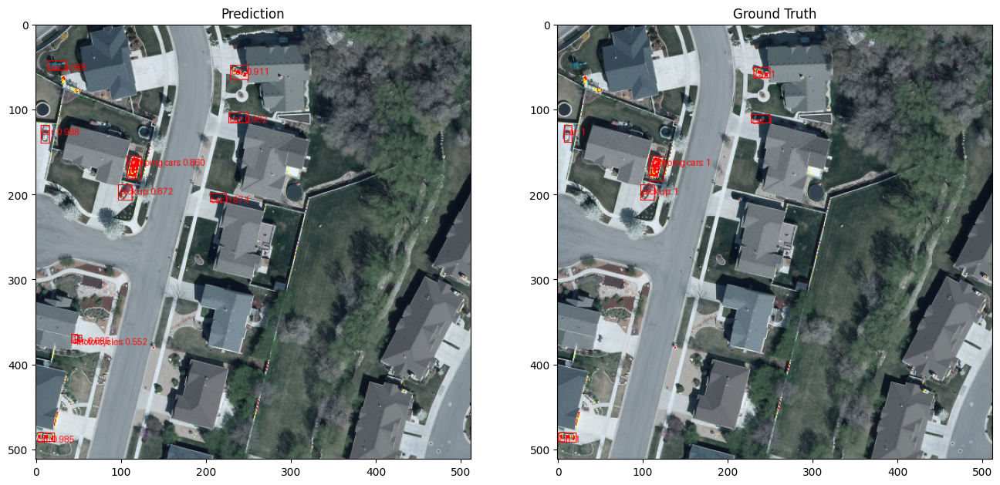

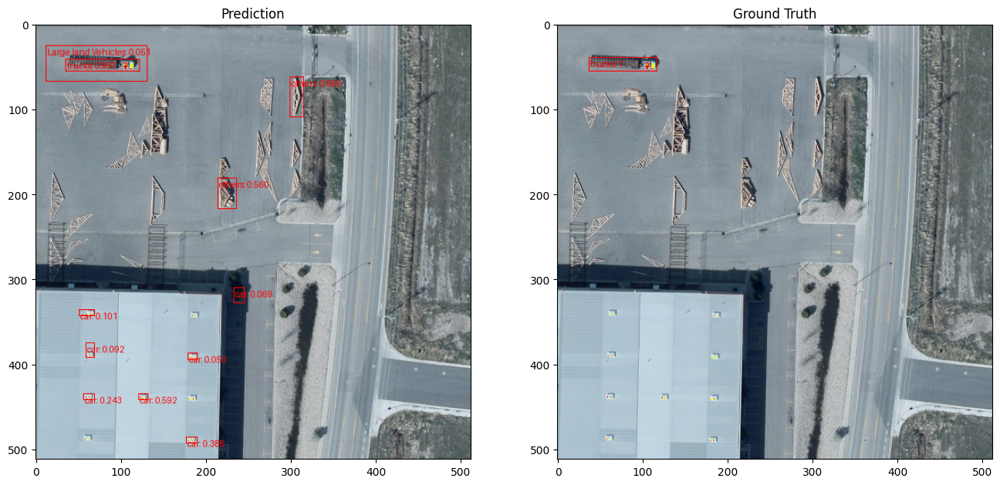

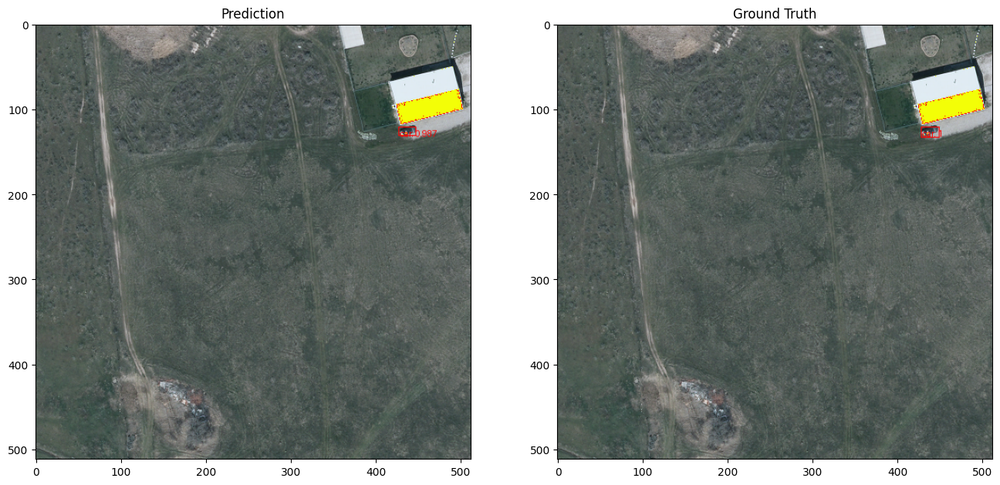

In [48]:
visualize_predictions(
    inputs,
    outputs,
    labels
)